<a href="https://colab.research.google.com/github/jeremyTobias/ohare_time_series/blob/main/ohare_time_series.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/googlecolab/colabtools/blob/master/notebooks/colab-github-demo.ipynb)


# Setup and data loading

In [ ]:
# Mount google drive

from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!pip install geopandas fbprophet

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import os

from datetime import datetime
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import adfuller
from fbprophet import Prophet

In [ ]:
data = pd.read_csv('gdrive/MyDrive/ohare_final.csv')
data.head()

,Unnamed: 0,index,TripID,Year,Month,Day,TripStartTimestamp,TripEndTimestamp,TripSeconds,TripMiles,Fare,Tip,AdditionalCharges,TripTotal,DriverPay,PickupCommunityArea,DropoffCommunityArea,PickupCentroidLatitude,PickupCentroidLongitude,DropoffCentroidLongitude,DropoffCentroidLatitude,TripRating
0,0,0,100,2019,February,Monday,2019-02-25 00:15:00,2019-02-25 00:30:00,881.0,8.9,5.0,0.0001,7.55,12.55,2.43,76,25,41.980264,-87.913625,-87.756047,41.890609,0.28
1,1,1,101,2018,November,Saturday,2018-11-17 01:15:00,2018-11-17 01:30:00,943.0,8.0,12.5,2.0000,7.50,22.00,8.83,76,17,41.980264,-87.913625,-87.806020,41.946511,0.94
2,2,2,102,2018,November,Sunday,2018-11-11 12:15:00,2018-11-11 12:45:00,1976.0,18.9,27.5,3.0000,2.50,33.00,19.23,76,28,41.980264,-87.913625,-87.663518,41.874005,0.97
3,3,3,103,2019,March,Friday,2019-03-01 09:15:00,2019-03-01 09:45:00,1236.0,10.6,15.0,0.0001,7.55,22.55,8.83,76,15,41.980264,-87.913625,-87.763399,41.954028,0.71
4,4,4,104,2019,February,Monday,2019-02-11 02:00:00,2019-02-11 02:15:00,786.0,6.3,10.0,2.0000,7.55,19.55,7.23,76,17,41.980264,-87.913625,-87.806020,41.946511,0.92


In [ ]:
month_dict = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',  
    5: 'May',  
    6: 'June',  
    7: 'July',  
    8: 'August',  
    9: 'September',  
    10: 'October',  
    11: 'November',
    12: 'December'
}

day_dict = {
    1: 'Sunday',
    2: 'Monday',
    3: 'Tuesday',
    4: 'Wednesday',
    5: 'Thursday',
    6: 'Friday',
    7: 'Saturday'
}

def categorizeMonthDay(df):
  df['Month'] = pd.Categorical(df['Month'], categories=list(month_dict.values()), ordered=True)
  df['Day'] = pd.Categorical(df['Day'], categories=list(day_dict.values()), ordered=True)

  return df

# default configs for chicago_viz
configs = {
    'title': '',
    'y': '',
    'color': 'Oranges',
    'tolerance': 0.0,
    'long': '',
    'lat': '',
    'area': '',
    'filename': '',
    'year': 0,
    'month': '',
    'week_num': 0
}

# chicago heat map visualization
def chicago_viz(df, configs):
  fig, ax = plt.subplots(1, figsize=(8, 6))
  ax.axis('off')
  # ax.set_title(configs['title'], fontdict={'fontsize': '18', 'fontweight' : '3'})

  color = configs['color']
  vmin, vmax = 0, df[configs['y']].max()
  sm = plt.cm.ScalarMappable(cmap=color, norm=plt.Normalize(vmin=vmin, vmax=vmax))
  sm._A = []
  cbar = fig.colorbar(sm)
  cbar.ax.tick_params(labelsize=15)

  tripfig = df.plot(configs['y'], 
                    cmap=color, 
                    linewidth=0.8, 
                    edgecolor='0.8', 
                    ax=ax)
  
  # for idx, row in df.iterrows():
    # if(row[configs['y']] > configs['tolerance']):
      # plt.annotate(s=f'{row[configs["area"]]} : {row["Community"]}', xy=(row[configs['long']], row[configs['lat']]), horizontalalignment='center', fontsize='large', color='black', wrap=True)
  
  annotation = f"{configs['year']} - {configs['month']}\nWeek {configs['week_num']}"

  tripfig.annotate(s=annotation,
            xy=(0.1, .5), xycoords='figure fraction',
            horizontalalignment='left', verticalalignment='top',
            fontsize=18)

  filepath = os.path.join('gdrive/MyDrive/data/anim_images', configs['filename'] + '.jpg')
  chart = tripfig.get_figure()
  chart.savefig(filepath, dpi=300)

  plt.show()

# Data munging

In [ ]:
data['Date'] = pd.to_datetime(data['TripStartTimestamp']).dt.date
data['TripStartTimestamp'] = pd.to_datetime(data['TripStartTimestamp'])
data = categorizeMonthDay(data)
data.head()

,Unnamed: 0,index,TripID,Year,Month,Day,TripStartTimestamp,TripEndTimestamp,TripSeconds,TripMiles,Fare,Tip,AdditionalCharges,TripTotal,DriverPay,PickupCommunityArea,DropoffCommunityArea,PickupCentroidLatitude,PickupCentroidLongitude,DropoffCentroidLongitude,DropoffCentroidLatitude,TripRating,Date
0,0,0,100,2019,February,Monday,2019-02-25 00:15:00,2019-02-25 00:30:00,881.0,8.9,5.0,0.0001,7.55,12.55,2.43,76,25,41.980264,-87.913625,-87.756047,41.890609,0.28,2019-02-25
1,1,1,101,2018,November,Saturday,2018-11-17 01:15:00,2018-11-17 01:30:00,943.0,8.0,12.5,2.0000,7.50,22.00,8.83,76,17,41.980264,-87.913625,-87.806020,41.946511,0.94,2018-11-17
2,2,2,102,2018,November,Sunday,2018-11-11 12:15:00,2018-11-11 12:45:00,1976.0,18.9,27.5,3.0000,2.50,33.00,19.23,76,28,41.980264,-87.913625,-87.663518,41.874005,0.97,2018-11-11
3,3,3,103,2019,March,Friday,2019-03-01 09:15:00,2019-03-01 09:45:00,1236.0,10.6,15.0,0.0001,7.55,22.55,8.83,76,15,41.980264,-87.913625,-87.763399,41.954028,0.71,2019-03-01
4,4,4,104,2019,February,Monday,2019-02-11 02:00:00,2019-02-11 02:15:00,786.0,6.3,10.0,2.0000,7.55,19.55,7.23,76,17,41.980264,-87.913625,-87.806020,41.946511,0.92,2019-02-11


In [ ]:
chitown = gpd.read_file('gdrive/MyDrive/chicago_area_comm.geojson')
chitown = chitown[['community', 'area_num_1', 'geometry']]
chitown.rename(columns= {'community': 'Community', 'area_num_1': 'CommunityArea'}, inplace=True)
chitown.head()

,Community,CommunityArea,geometry
0,DOUGLAS,35,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ..."
1,OAKLAND,36,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ..."
2,FULLER PARK,37,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ..."
3,GRAND BOULEVARD,38,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ..."
4,KENWOOD,39,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ..."


# EDA

## Dropoffs at O'Hare

In [ ]:
data['week_number'] = data['TripStartTimestamp'].dt.isocalendar().week

data['count'] = 1
data_geo = data.groupby(['Year', 'Month', 'Day', 'week_number', 'PickupCommunityArea'])[['TripRating', 'PickupCentroidLongitude', 'PickupCentroidLatitude',]].mean().reset_index()
counts = data.groupby(['Year', 'Month', 'Day', 'week_number', 'PickupCommunityArea']).count()[['count']].reset_index()

counts['PickupCommunityArea'] = [str(int(x)) for x in counts['PickupCommunityArea']] 
data_geo['PickupCommunityArea'] = [str(int(x)) for x in data_geo['PickupCommunityArea']]

data_geo = pd.merge(data_geo, counts, on=['Year', 'Month', 'Day', 'week_number', 'PickupCommunityArea'])
data_geo.head()

,Year,Month,Day,week_number,PickupCommunityArea,TripRating,PickupCentroidLongitude,PickupCentroidLatitude,count
0,2018,January,Sunday,1,1,NaN,NaN,NaN,NaN
1,2018,January,Sunday,1,2,NaN,NaN,NaN,NaN
2,2018,January,Sunday,1,3,NaN,NaN,NaN,NaN
3,2018,January,Sunday,1,4,NaN,NaN,NaN,NaN
4,2018,January,Sunday,1,5,NaN,NaN,NaN,NaN


In [ ]:
chitown['CommunityArea'] = chitown['CommunityArea'].astype(str)
chitown_pickup = pd.merge(chitown, data_geo, left_on='CommunityArea', right_on='PickupCommunityArea').drop('CommunityArea', axis='columns')
chitown_pickup.dropna(inplace=True)
chitown_pickup.head()

,Community,geometry,Year,Month,Day,week_number,PickupCommunityArea,TripRating,PickupCentroidLongitude,PickupCentroidLatitude,count
3753,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,44,35,0.907857,-87.618678,41.835118,14.0
3754,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,45,35,1.007273,-87.618678,41.835118,11.0
3755,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,46,35,0.707500,-87.618678,41.835118,12.0
3756,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,47,35,0.850909,-87.618678,41.835118,11.0
3807,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Monday,45,35,0.869000,-87.618678,41.835118,10.0


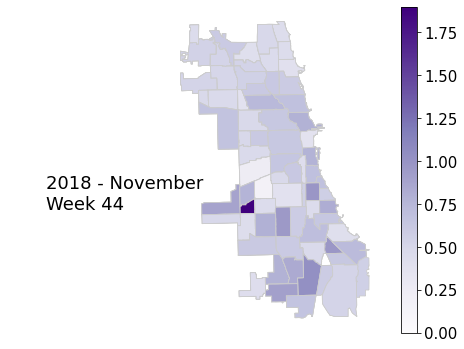

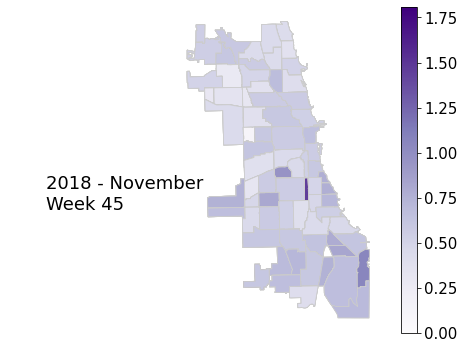

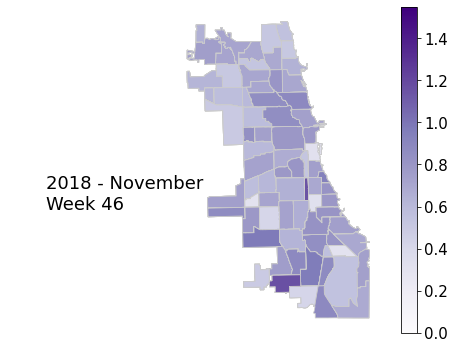

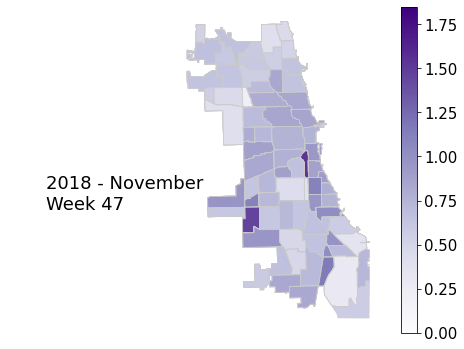

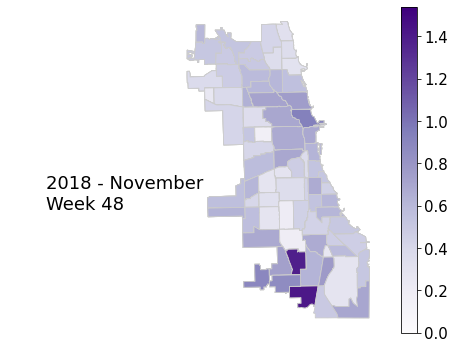

...

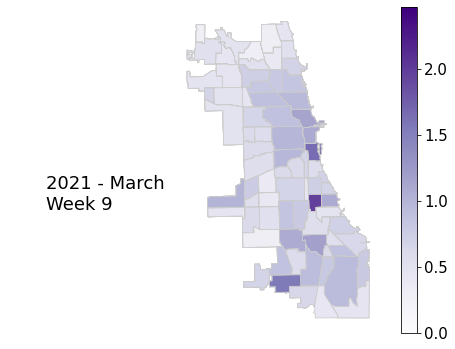

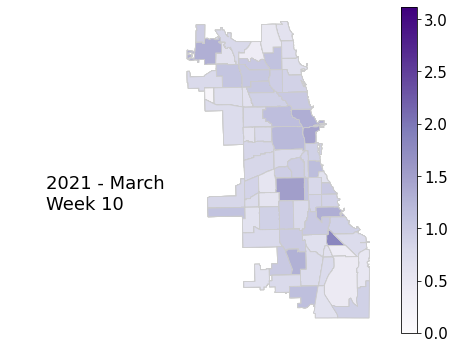

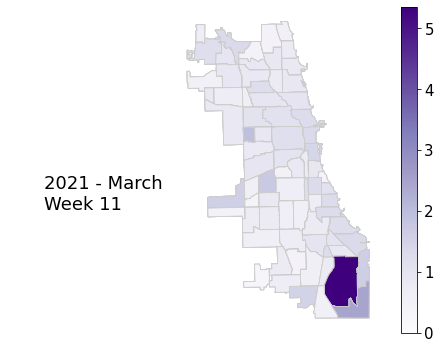

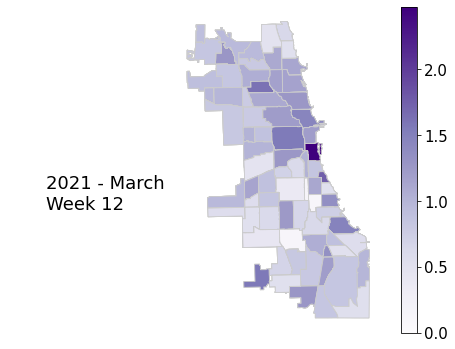

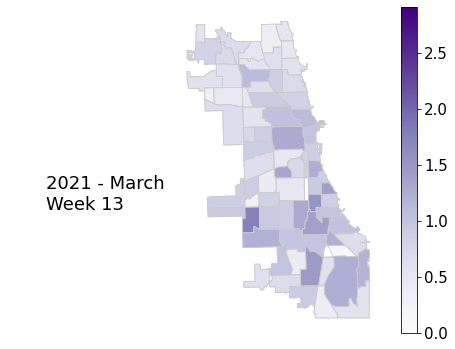

In [ ]:
configs['y'] = 'TripRating'
configs['color'] = 'Purples'
configs['tolerance'] = 1.05
configs['long'] = 'PickupCentroidLongitude'
configs['lat'] = 'PickupCentroidLatitude'
configs['area'] = 'PickupCommunityArea'

ohare_dropoffs = chitown_pickup[chitown_pickup['PickupCommunityArea'] != '76']

test_anim = ohare_dropoffs[ohare_dropoffs['Year'] >= 2018]

test_anim = categorizeMonthDay(test_anim)

for day, df in test_anim.groupby(['Year', 'Month', 'week_number']):
  configs['year'] = day[0]
  configs['month'] = day[1]
  configs['week_num'] = day[2]
  configs['filename'] = f'image_{day[0]}_{day[2]}'
  # configs['title'] = 'O\'Hare Dropoffs Median Trip Rating'
  chicago_viz(df, configs)

## Pickups at O'Hare

In [ ]:
data['week_number'] = data['TripStartTimestamp'].dt.isocalendar().week

data['count'] = 1
data_geo = data.groupby(['Year', 'Month', 'Day', 'week_number', 'DropoffCommunityArea'])[['TripRating', 'DropoffCentroidLongitude', 'DropoffCentroidLatitude',]].mean().reset_index()
counts = data.groupby(['Year', 'Month', 'Day', 'week_number', 'DropoffCommunityArea']).count()[['count']].reset_index()

counts['DropoffCommunityArea'] = [str(int(x)) for x in counts['DropoffCommunityArea']]
data_geo['DropoffCommunityArea'] = [str(int(x)) for x in data_geo['DropoffCommunityArea']]

data_geo = pd.merge(data_geo, counts, on=['Year', 'Month', 'Day', 'week_number', 'DropoffCommunityArea'])
data_geo.head()

,Year,Month,Day,week_number,DropoffCommunityArea,TripRating,DropoffCentroidLongitude,DropoffCentroidLatitude,count
0,2018,January,Sunday,1,1,NaN,NaN,NaN,NaN
1,2018,January,Sunday,1,2,NaN,NaN,NaN,NaN
2,2018,January,Sunday,1,3,NaN,NaN,NaN,NaN
3,2018,January,Sunday,1,4,NaN,NaN,NaN,NaN
4,2018,January,Sunday,1,5,NaN,NaN,NaN,NaN


In [ ]:
chitown['CommunityArea'] = chitown['CommunityArea'].astype(str)
chitown_dropoff = pd.merge(chitown, data_geo, left_on='CommunityArea', right_on='DropoffCommunityArea').drop('CommunityArea', axis='columns')
chitown_dropoff.dropna(inplace=True)
chitown_dropoff.head()

,Community,geometry,Year,Month,Day,week_number,DropoffCommunityArea,TripRating,DropoffCentroidLongitude,DropoffCentroidLatitude,count
3753,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,44,35,0.751429,-87.618678,41.835118,7.0
3754,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,45,35,0.765714,-87.618678,41.835118,14.0
3755,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,46,35,0.884444,-87.618678,41.835118,9.0
3756,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Sunday,47,35,0.792000,-87.618678,41.835118,15.0
3807,DOUGLAS,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",2018,November,Monday,45,35,0.702500,-87.618678,41.835118,12.0


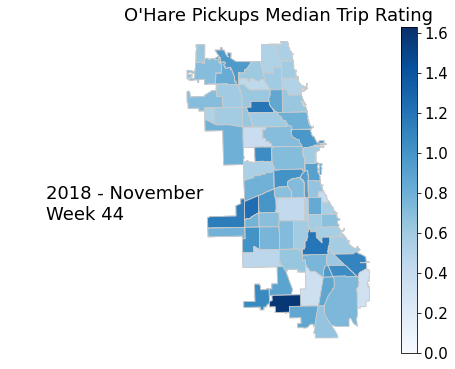

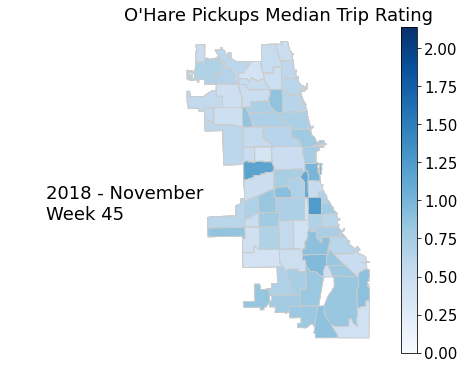

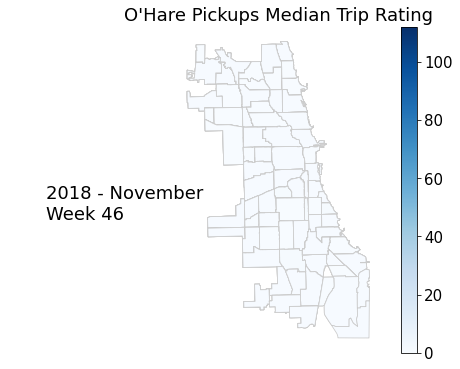

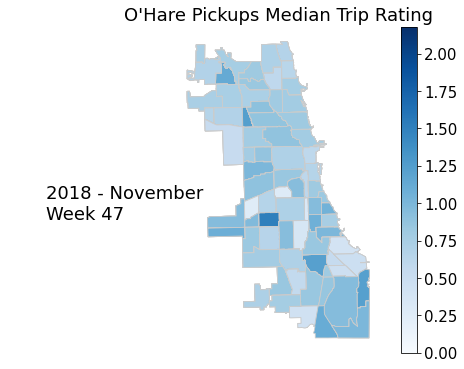

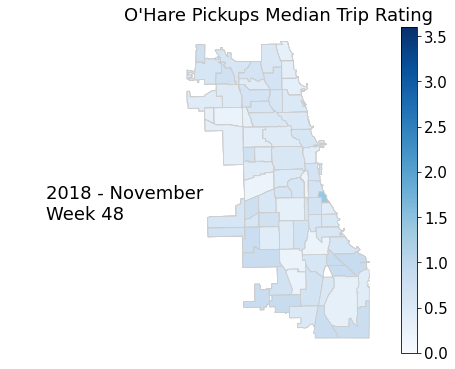

...

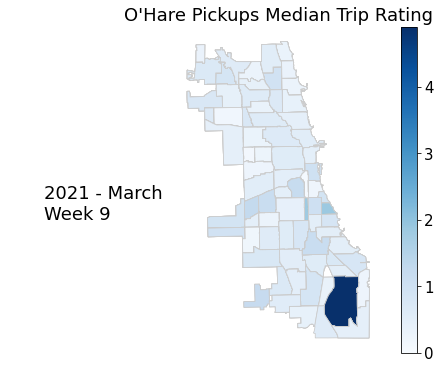

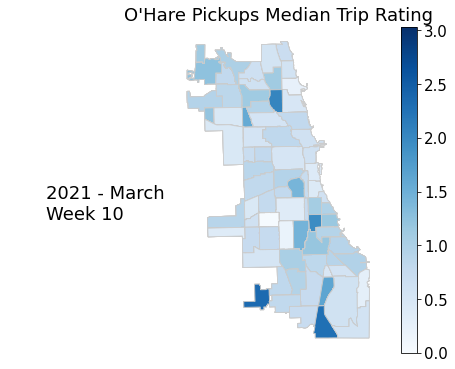

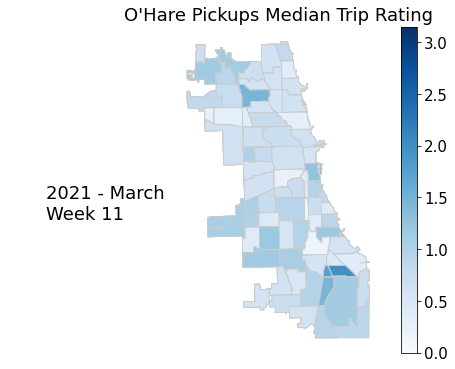

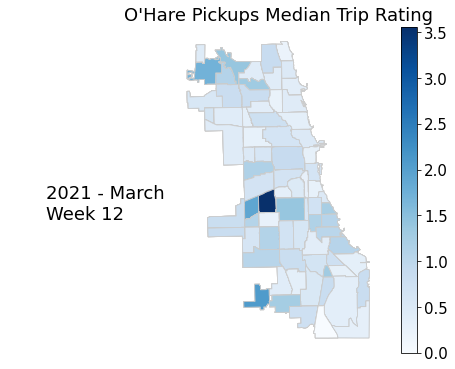

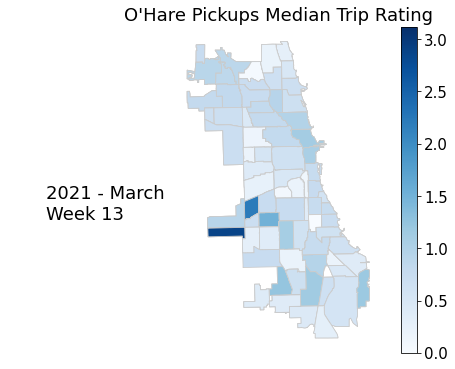

In [ ]:
configs['y'] = 'TripRating'
configs['color'] = 'Blues'
configs['tolerance'] = 1.05
configs['long'] = 'DropoffCentroidLongitude'
configs['lat'] = 'DropoffCentroidLatitude'
configs['area'] = 'DropoffCommunityArea'

ohare_pickups = chitown_dropoff[chitown_dropoff['DropoffCommunityArea'] != '76']

test_anim = ohare_pickups[ohare_pickups['Year'] >= 2018]

test_anim = categorizeMonthDay(test_anim)

for day, df in test_anim.groupby(['Year', 'Month', 'week_number']):
  configs['year'] = day[0]
  configs['month'] = day[1]
  configs['week_num'] = day[2]
  configs['filename'] = f'image_{day[0]}_{day[2]}'
  configs['title'] = 'O\'Hare Pickups Median Trip Rating'
  chicago_viz(df, configs)

## Trip counts by year

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should

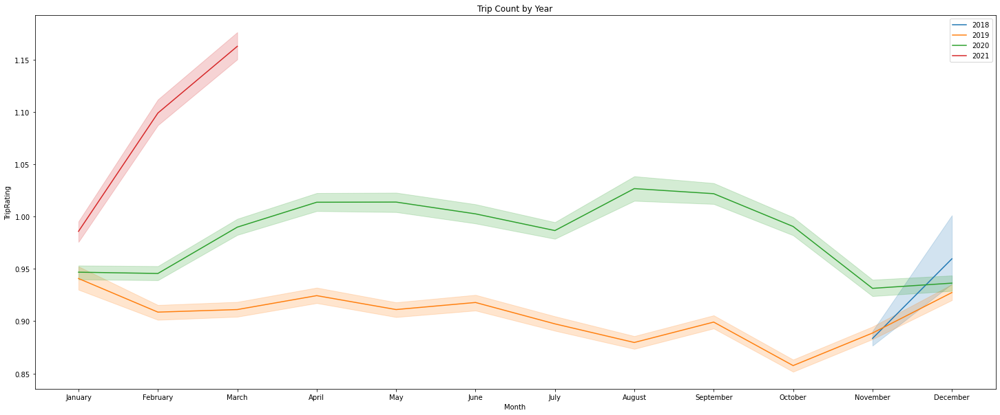

In [ ]:
fig = plt.figure(figsize=(25,10))
for yr, df in ohare_dropoffs.groupby(['Year']):
  sns.lineplot(x=df['Month'].sort_values(), y=df['TripRating'], label=yr)

plt.title('Trip Count by Year')
plt.show()

## Median Trip Rating

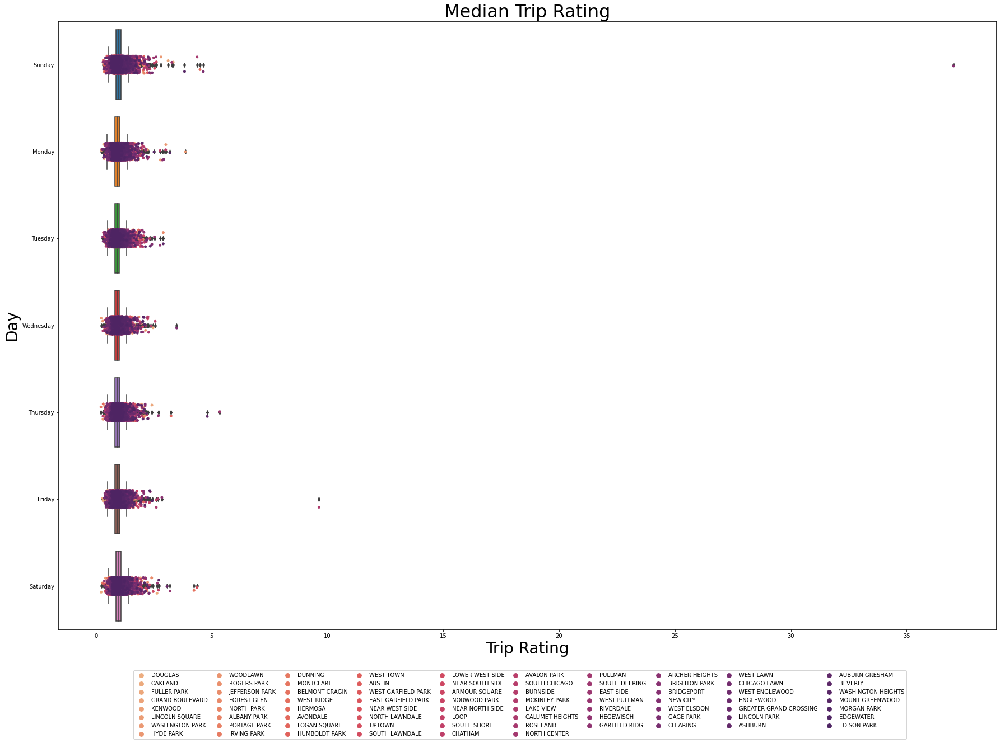

In [ ]:
fig = plt.subplots(figsize=(30,20))

ax = sns.boxplot(y='Day', x='TripRating', data=ohare_dropoffs)
ax = sns.stripplot(y='Day', x='TripRating', hue='Community', palette='flare', data=ohare_dropoffs)
ax.set_xlabel('Trip Rating', size=28)
ax.set_ylabel('Day', size=28)
ax.set_title('Median Trip Rating', size=32)
plt.legend(ncol=10, columnspacing=1, loc=(0.08, -0.18))
plt.show()

## Circular Barplot

In [ ]:
df = data.copy()
df['count'] = 1
count = df.groupby(['PickupCommunityArea']).count()[['count']].reset_index()
count = count[count['PickupCommunityArea'] != 76]
count.head()

,PickupCommunityArea,count
0,1,20525
1,2,23001
2,3,22127
3,4,26373
4,5,37127


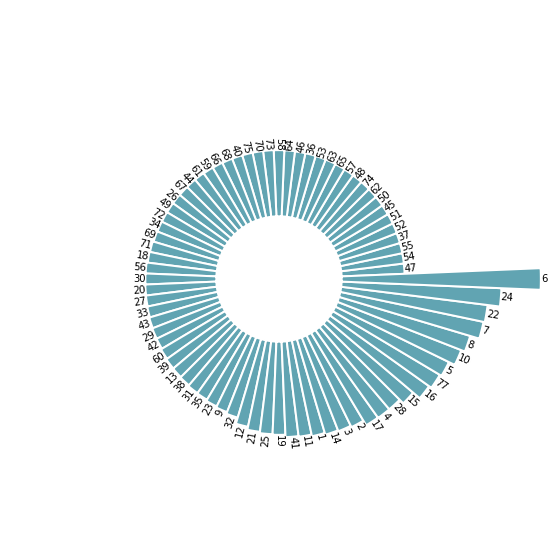

In [ ]:
df = count.copy()
df = df.sort_values(by='count')

# https://www.python-graph-gallery.com/circular-barplot-basic
# set figure size
plt.figure(figsize=(20,10))

# plot polar axis
ax = plt.subplot(111, polar=True)

# remove grid
plt.axis('off')

# Set the coordinates limits
upperLimit = 100000
lowerLimit = 25000

# Compute max and min in the dataset
max = df['count'].max()

# Let's compute heights: they are a conversion of each item value in those new coordinates
# In our example, 0 in the dataset will be converted to the lowerLimit (10)
# The maximum will be converted to the upperLimit (100)
slope = (max - lowerLimit) / max
heights = slope * df['count'] + lowerLimit

# Compute the width of each bar. In total we have 2*Pi = 360°
width = 2*np.pi / len(df.index)

# Compute the angle each bar is centered on:
indexes = list(range(1, len(df.index)+1))
angles = [element * width for element in indexes]
angles

# Draw bars
bars = ax.bar(
    x=angles, 
    height=heights, 
    width=width, 
    bottom=lowerLimit,
    linewidth=2, 
    edgecolor="white",
    color="#61a4b2")

# little space between the bar and the label
labelPadding = 4

# Add labels
for bar, angle, height, label in zip(bars,angles, heights, df["PickupCommunityArea"]):

    # Labels are rotated. Rotation must be specified in degrees :(
    rotation = np.rad2deg(angle)

    # Flip some labels upside down
    alignment = ""
    if angle >= np.pi/2 and angle < 3*np.pi/2:
        alignment = "right"
        rotation = rotation + 180
    else: 
        alignment = "left"

    # Finally add the labels
    ax.text(
        x=angle, 
        y=lowerLimit + bar.get_height() + labelPadding, 
        s=label, 
        ha=alignment, 
        va='center', 
        rotation=rotation, 
        rotation_mode="anchor") 

# Time Series

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import adfuller
from fbprophet import Prophet

In [ ]:
ohare_21 = data[data['Year'] >= 2021].drop(['index', 'TripID'],axis=1)
ohare_21['TripStartTimestamp'] = pd.to_datetime(ohare_21['TripStartTimestamp'])
ohare_21['WeekNumber'] = ohare_21['TripStartTimestamp'].dt.isocalendar().week
ohare_21.head()

,Unnamed: 0,Year,Month,Day,TripStartTimestamp,TripEndTimestamp,TripSeconds,TripMiles,Fare,Tip,AdditionalCharges,TripTotal,DriverPay,PickupCommunityArea,DropoffCommunityArea,PickupCentroidLatitude,PickupCentroidLongitude,DropoffCentroidLongitude,DropoffCentroidLatitude,TripRating,Date,week_number,count,WeekNumber
361893,362308,2021,January,Friday,2021-01-15 17:15:00,2021-01-15 17:45:00,1498.0,10.3,17.5,0.0001,3.10,20.60,10.43,76,20,41.980264,-87.913625,-87.734740,41.924347,0.70,2021-01-15,2,1,2
361894,362309,2021,January,Tuesday,2021-01-19 09:30:00,2021-01-19 09:45:00,705.0,7.0,10.0,0.0001,3.10,13.10,5.63,76,16,41.980264,-87.913625,-87.723452,41.953582,0.80,2021-01-19,3,1,3
361896,362311,2021,January,Saturday,2021-01-30 14:00:00,2021-01-30 14:30:00,1614.0,10.5,22.5,0.0001,1.23,23.73,13.63,76,6,41.980264,-87.913625,-87.655998,41.944227,0.84,2021-01-30,4,1,4
361897,362312,2021,January,Wednesday,2021-01-06 19:15:00,2021-01-06 19:15:00,416.0,4.4,10.0,0.0001,8.10,18.10,5.63,76,10,41.980264,-87.913625,-87.804532,41.985015,1.35,2021-01-06,1,1,1
361898,362313,2021,January,Monday,2021-01-04 21:00:00,2021-01-04 21:30:00,2104.0,25.0,30.0,6.0000,6.33,42.33,23.23,76,42,41.980264,-87.913625,-87.594925,41.778877,1.10,2021-01-04,1,1,1


In [ ]:
ohare_feb_plus = ohare_21[ohare_21['Month'] >= 'February']
pd.unique(ohare_feb_plus['Month'])

['February', 'March']
Categories (2, object): ['February' < 'March']

In [ ]:
ohare_21_do = ohare_feb_plus[ohare_feb_plus['PickupCommunityArea'] != 76]
ohare_21_pu = ohare_feb_plus[ohare_feb_plus['DropoffCommunityArea'] != 76]

In [ ]:
ohare_21_do.head()

,Unnamed: 0,Year,Month,Day,TripStartTimestamp,TripEndTimestamp,TripSeconds,TripMiles,Fare,Tip,AdditionalCharges,TripTotal,DriverPay,PickupCommunityArea,DropoffCommunityArea,PickupCentroidLatitude,PickupCentroidLongitude,DropoffCentroidLongitude,DropoffCentroidLatitude,TripRating,Date,week_number,count,WeekNumber
1317330,1318692,2021,February,Friday,2021-02-05 16:45:00,2021-02-05 17:45:00,3017.0,23.2,27.5,5.0000,9.70,42.20,20.83,36,76,41.823713,-87.602350,-87.913625,41.980264,0.69,2021-02-05,5,1,5
1317331,1318693,2021,February,Wednesday,2021-02-03 13:45:00,2021-02-03 14:30:00,2273.0,25.2,75.0,0.0001,5.11,80.11,47.23,40,76,41.792357,-87.617931,-87.913625,41.980264,2.08,2021-02-03,5,1,5
1317332,1318694,2021,February,Saturday,2021-02-06 01:30:00,2021-02-06 01:45:00,1099.0,9.6,17.5,3.0000,4.01,24.51,12.83,4,76,41.975171,-87.687516,-87.913625,41.980264,1.17,2021-02-06,5,1,5
1317335,1318697,2021,February,Thursday,2021-02-25 07:15:00,2021-02-25 08:15:00,3099.0,32.1,37.5,0.0001,11.49,48.99,23.23,53,76,41.673820,-87.635740,-87.913625,41.980264,0.75,2021-02-25,8,1,8
1317336,1318698,2021,February,Monday,2021-02-22 05:15:00,2021-02-22 05:30:00,1180.0,10.4,22.5,0.0001,6.20,28.70,13.63,15,76,41.954028,-87.763399,-87.913625,41.980264,1.16,2021-02-22,8,1,8


In [ ]:
ohare_21_pu.head()

,Unnamed: 0,Year,Month,Day,TripStartTimestamp,TripEndTimestamp,TripSeconds,TripMiles,Fare,Tip,AdditionalCharges,TripTotal,DriverPay,PickupCommunityArea,DropoffCommunityArea,PickupCentroidLatitude,PickupCentroidLongitude,DropoffCentroidLongitude,DropoffCentroidLatitude,TripRating,Date,week_number,count,WeekNumber
437949,438426,2021,February,Sunday,2021-02-21 12:00:00,2021-02-21 12:15:00,939.0,9.5,12.5,3.0000,8.10,23.60,9.63,76,16,41.980264,-87.913625,-87.723452,41.953582,1.03,2021-02-21,7,1,7
437950,438427,2021,February,Wednesday,2021-02-03 08:45:00,2021-02-03 08:45:00,558.0,2.8,7.5,0.0001,3.10,10.60,4.03,76,11,41.980264,-87.913625,-87.771167,41.978830,0.72,2021-02-03,5,1,5
437954,438431,2021,February,Monday,2021-02-15 23:30:00,2021-02-16 00:15:00,2046.0,17.6,47.5,11.0000,5.00,63.50,38.43,76,8,41.980264,-87.913625,-87.633308,41.899602,1.88,2021-02-15,7,1,7
437956,438433,2021,February,Friday,2021-02-05 10:45:00,2021-02-05 11:00:00,1512.0,14.7,22.5,0.0001,6.20,28.70,13.63,76,24,41.980264,-87.913625,-87.676356,41.901207,0.90,2021-02-05,5,1,5
437957,438434,2021,February,Wednesday,2021-02-10 09:45:00,2021-02-10 10:00:00,993.0,13.1,22.5,6.0000,8.66,37.16,18.43,76,22,41.980264,-87.913625,-87.699155,41.922761,1.86,2021-02-10,6,1,6


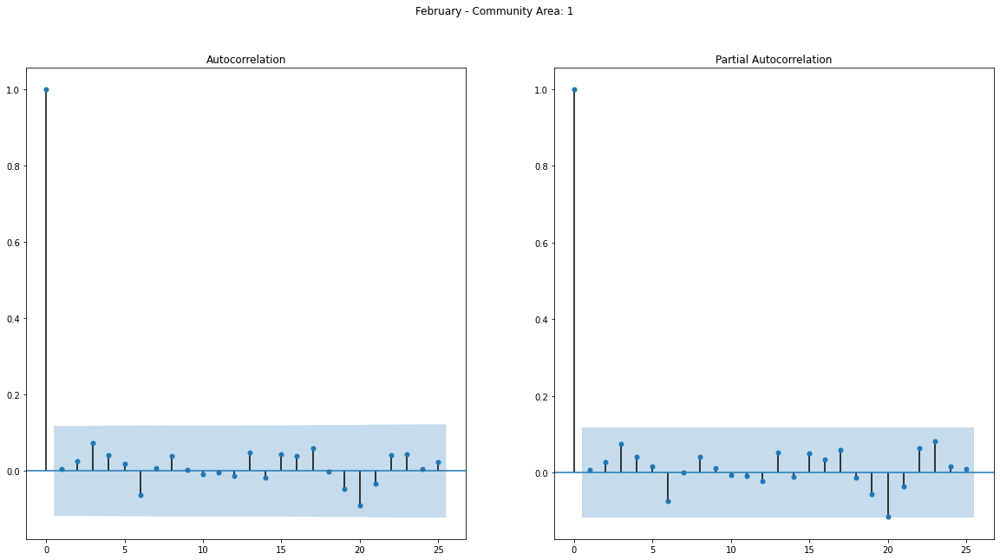

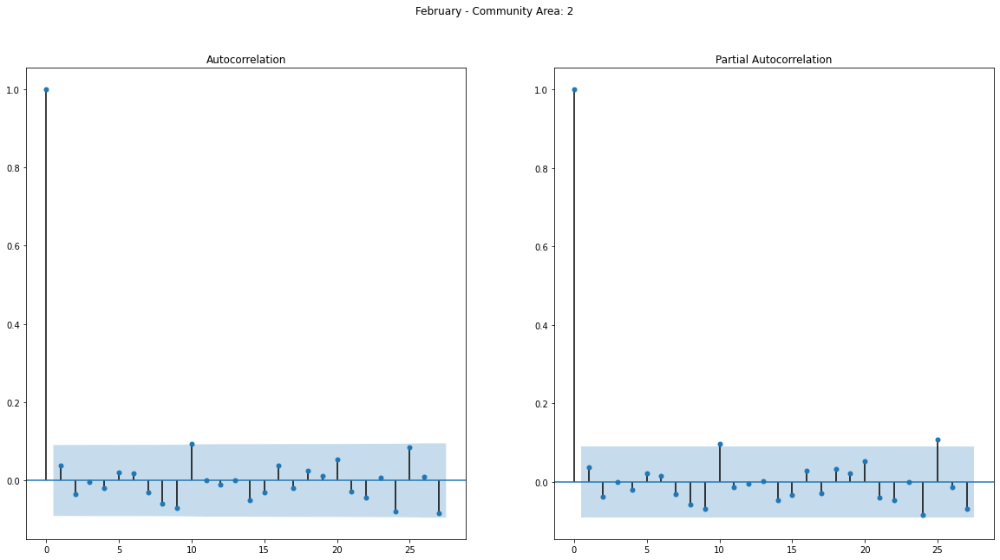

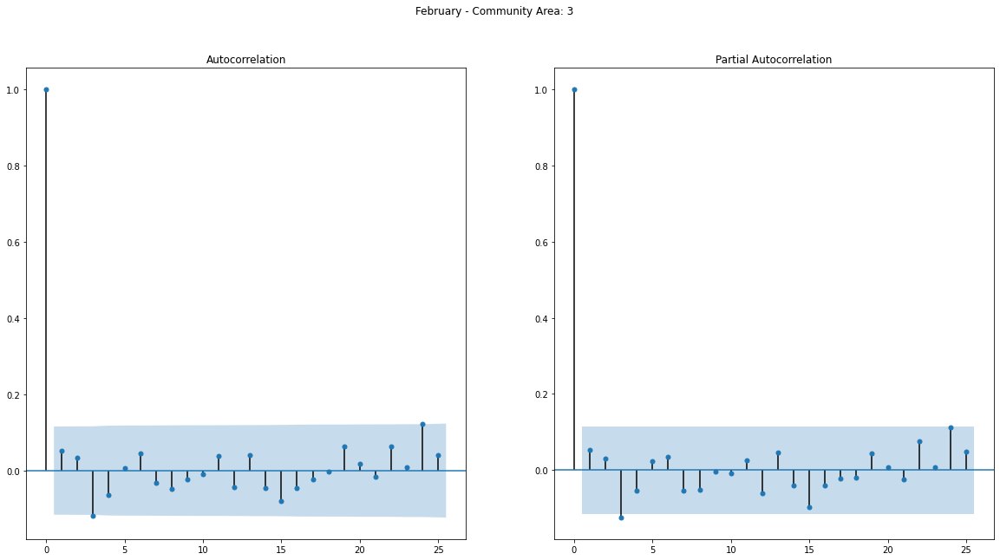

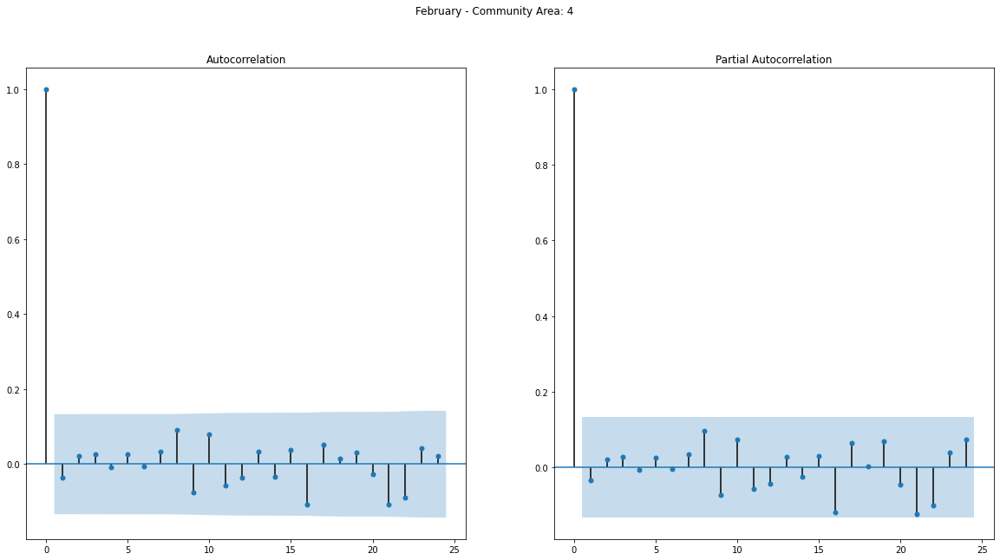

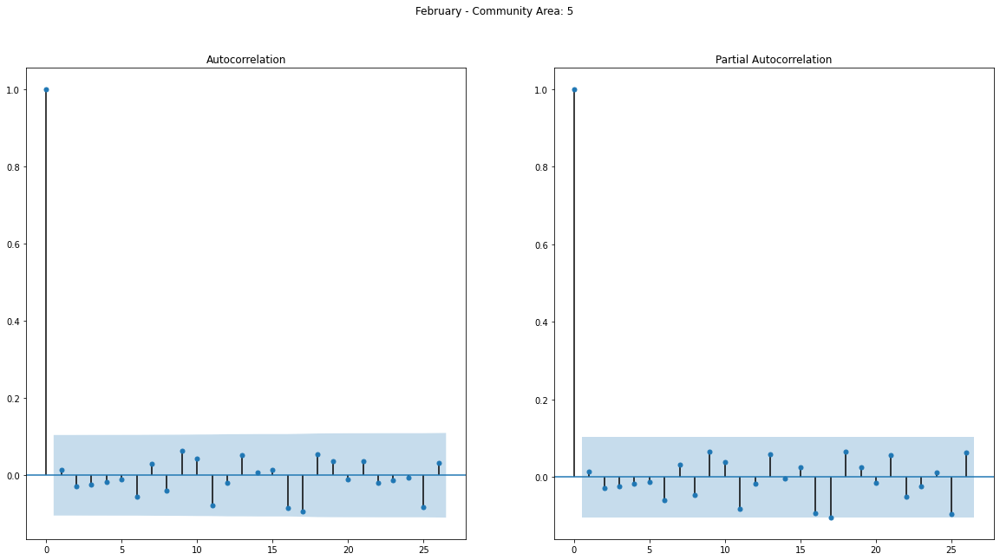

...

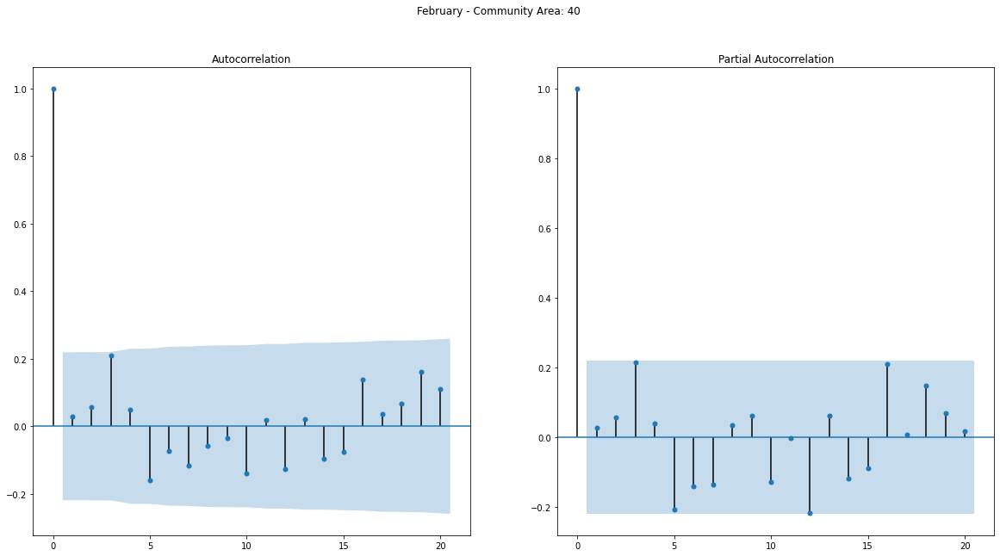

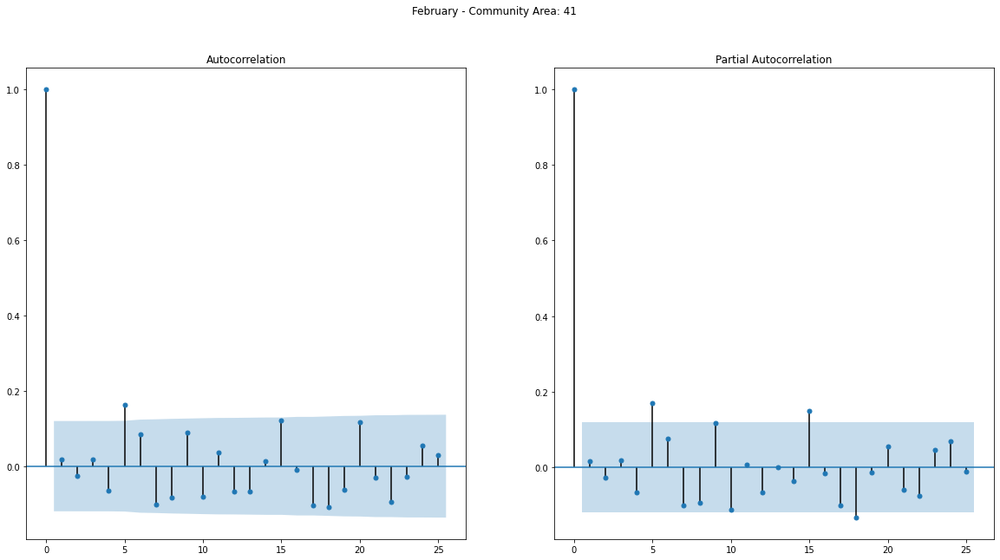

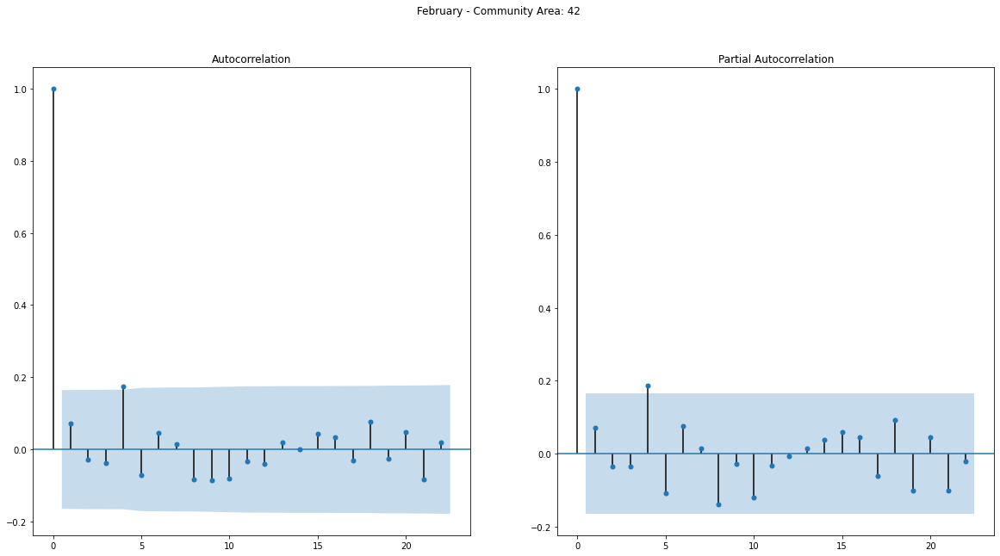

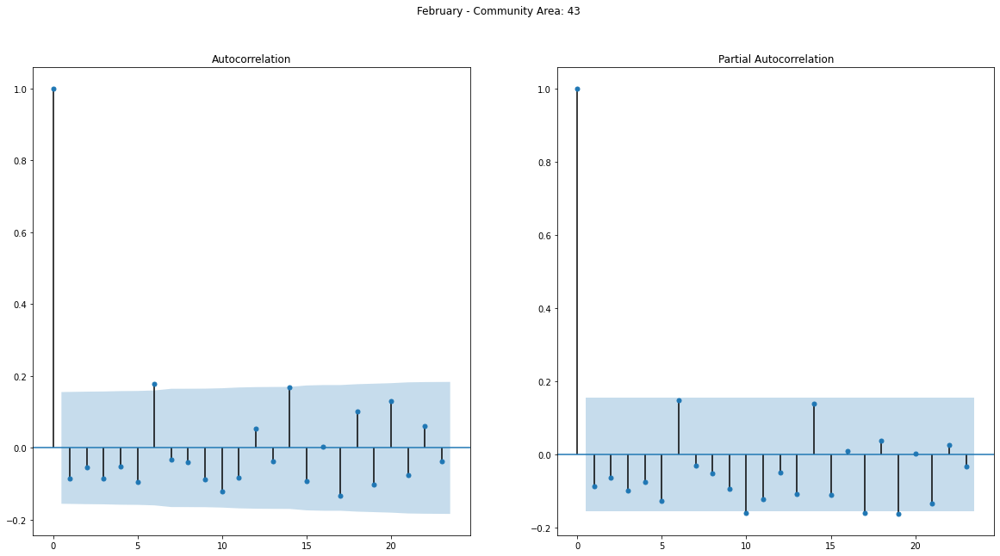

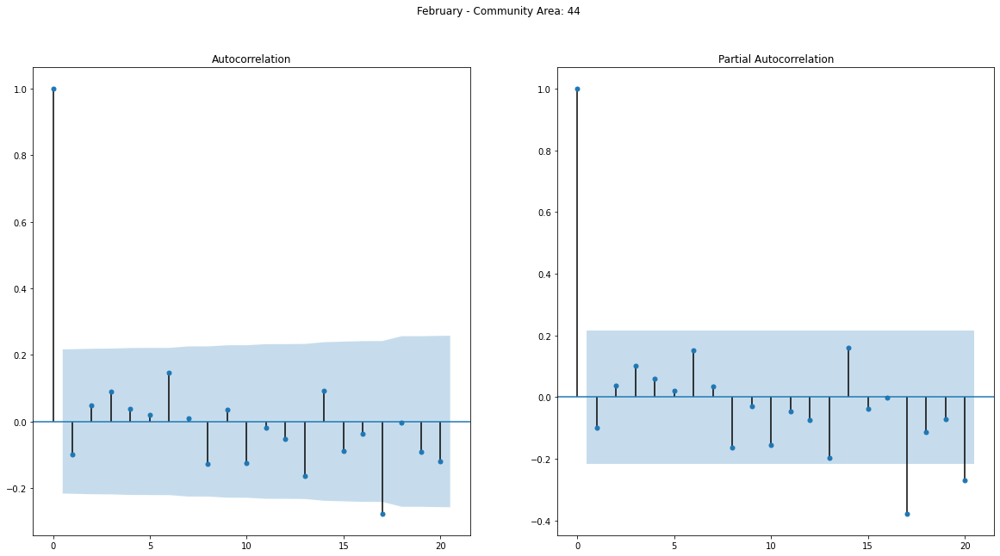

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



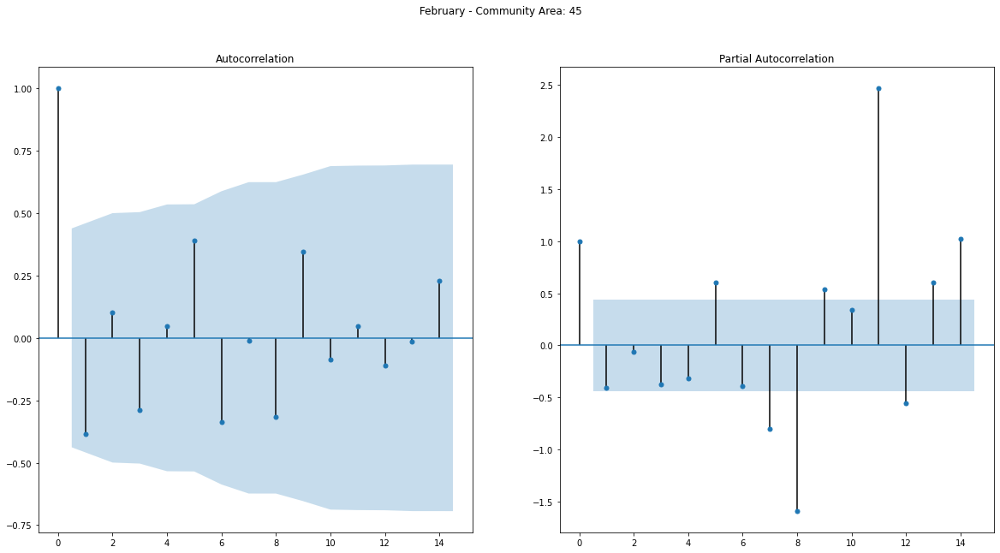

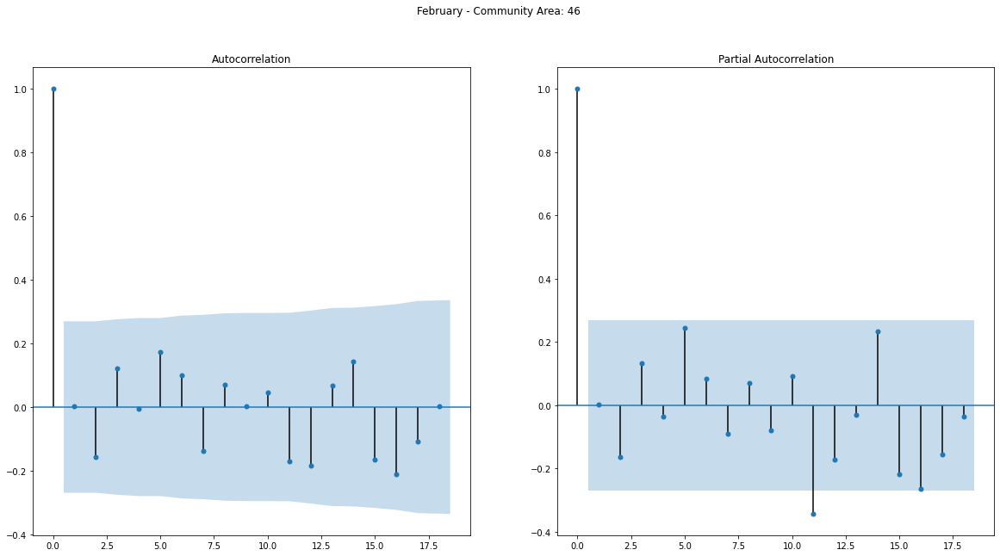

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



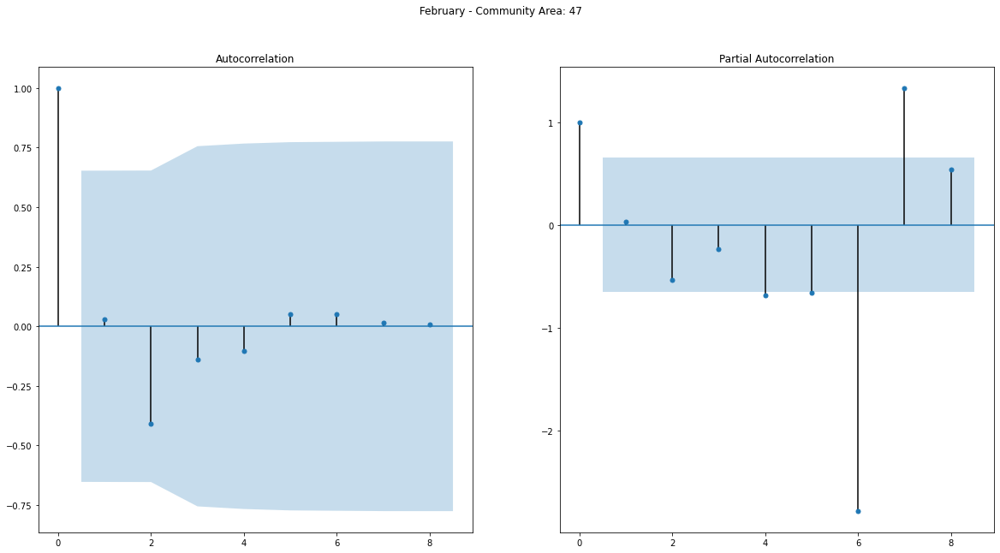

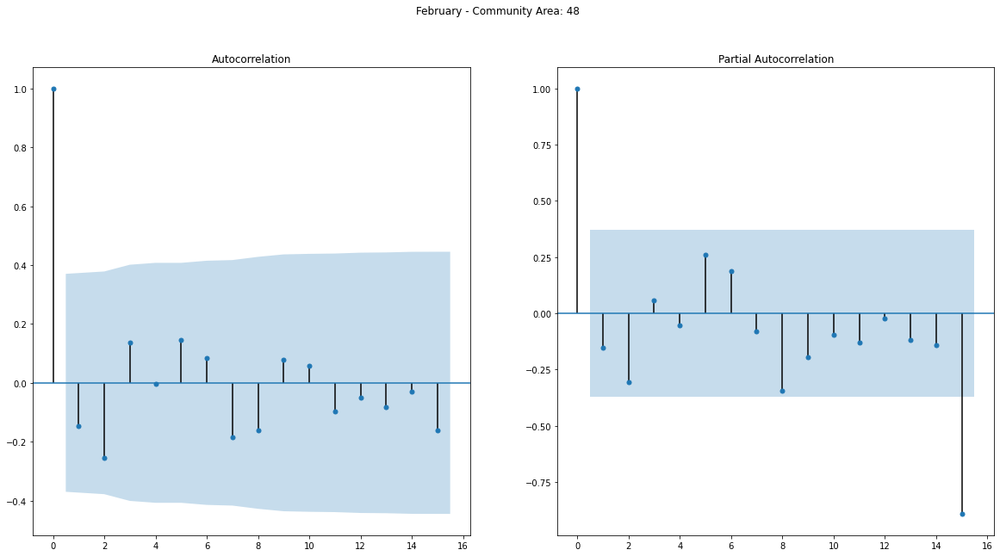

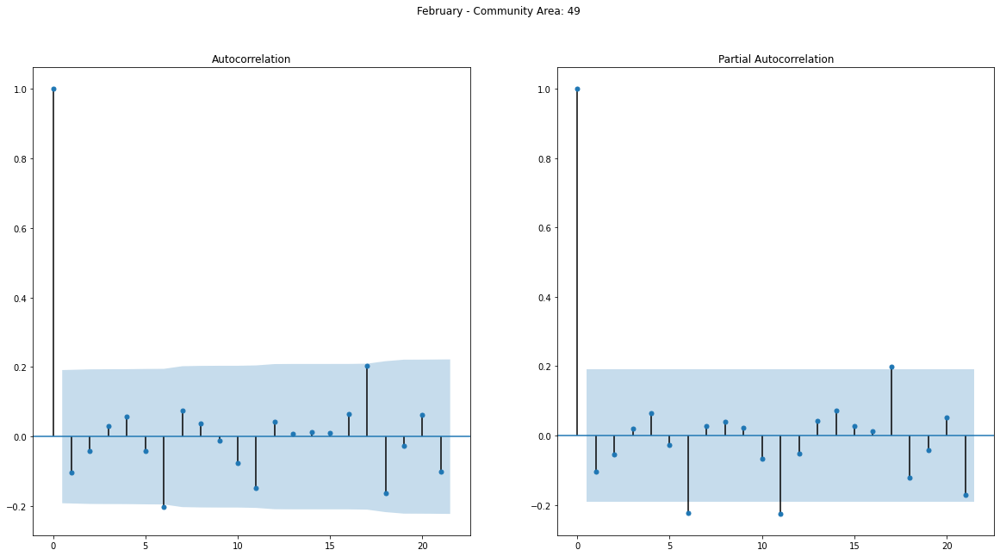

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



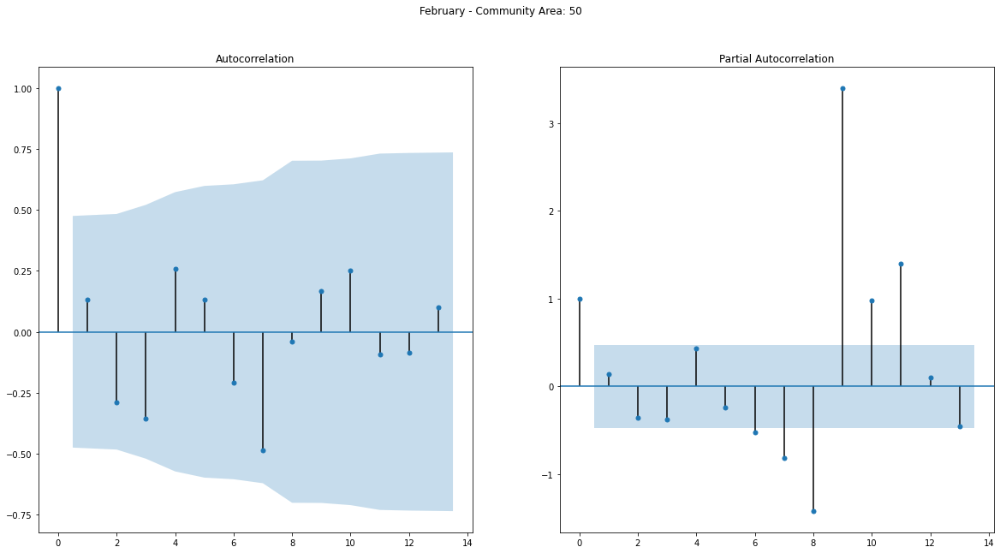

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



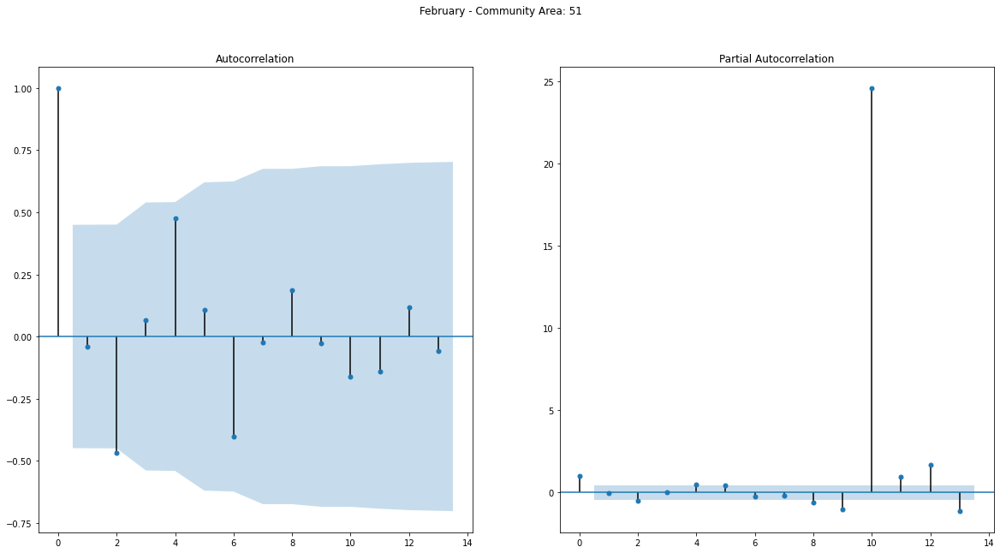

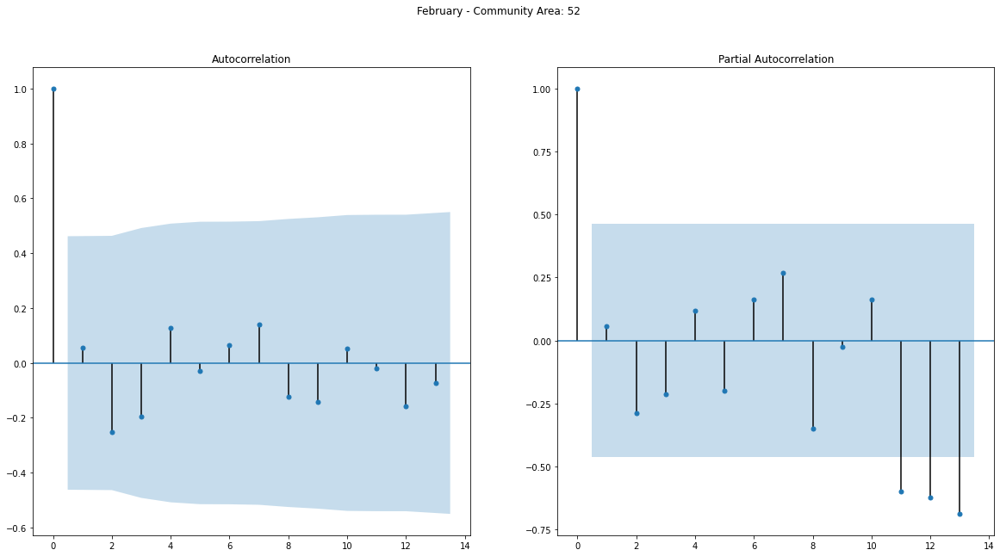

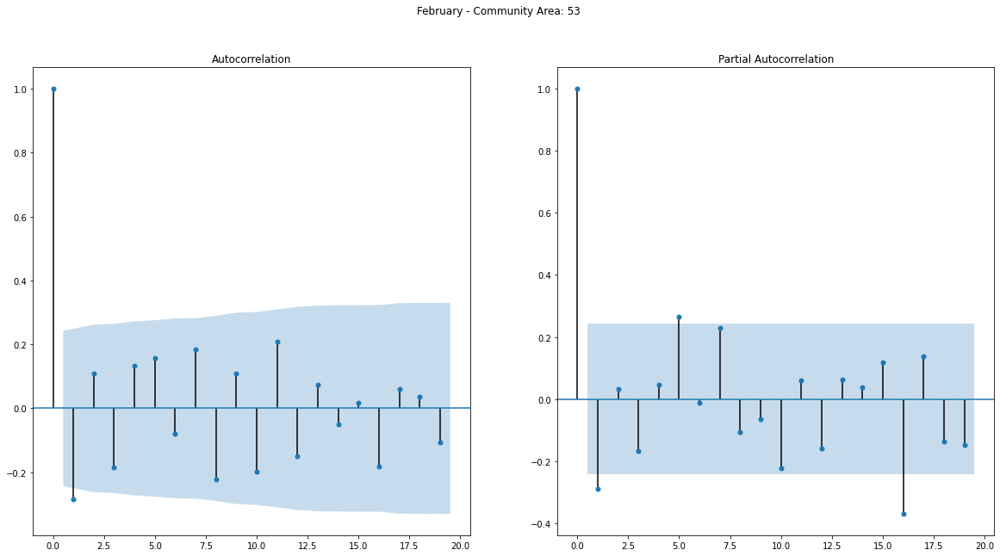

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



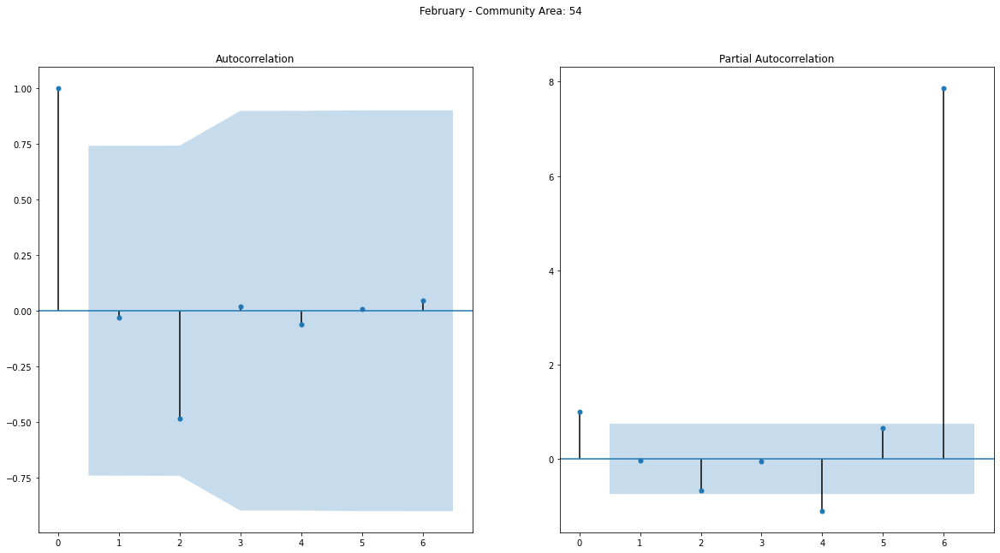

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



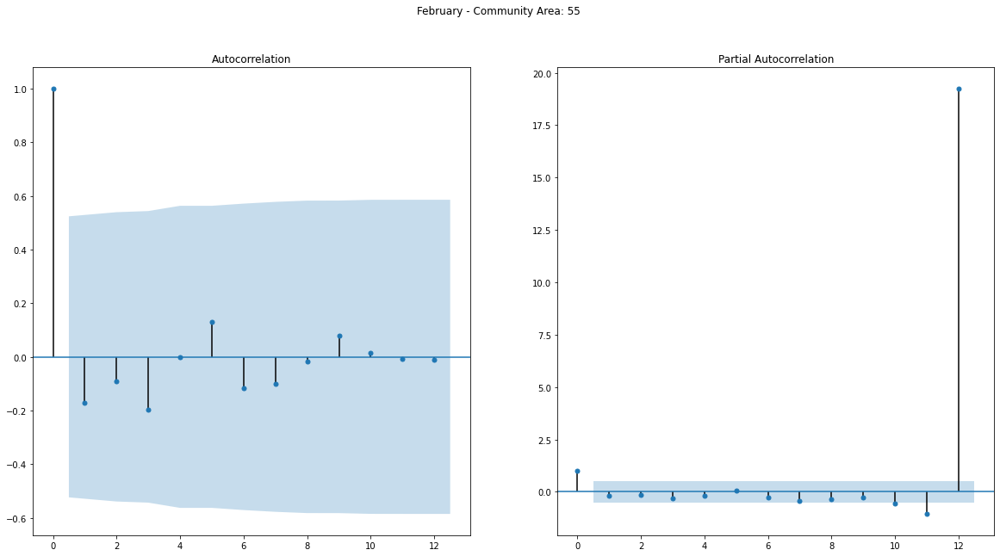

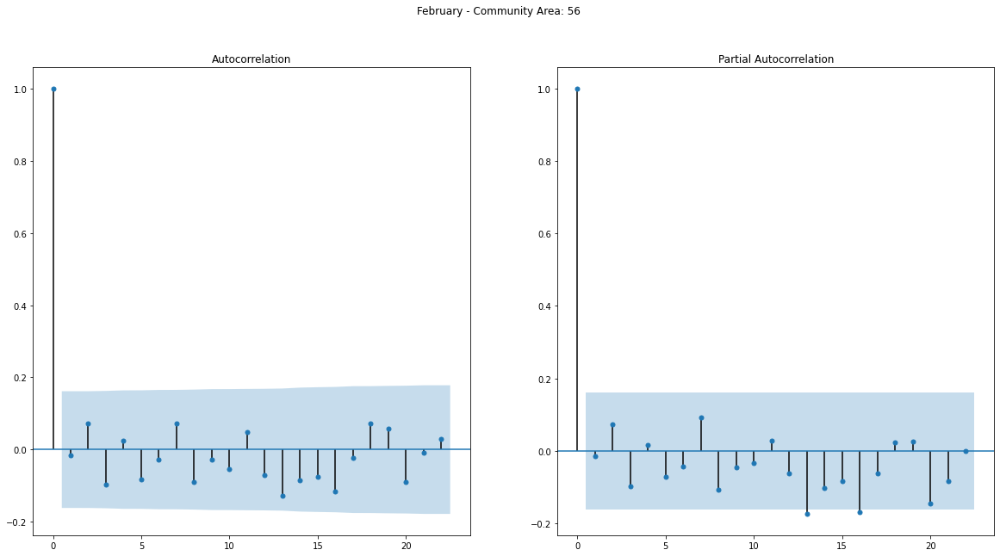

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



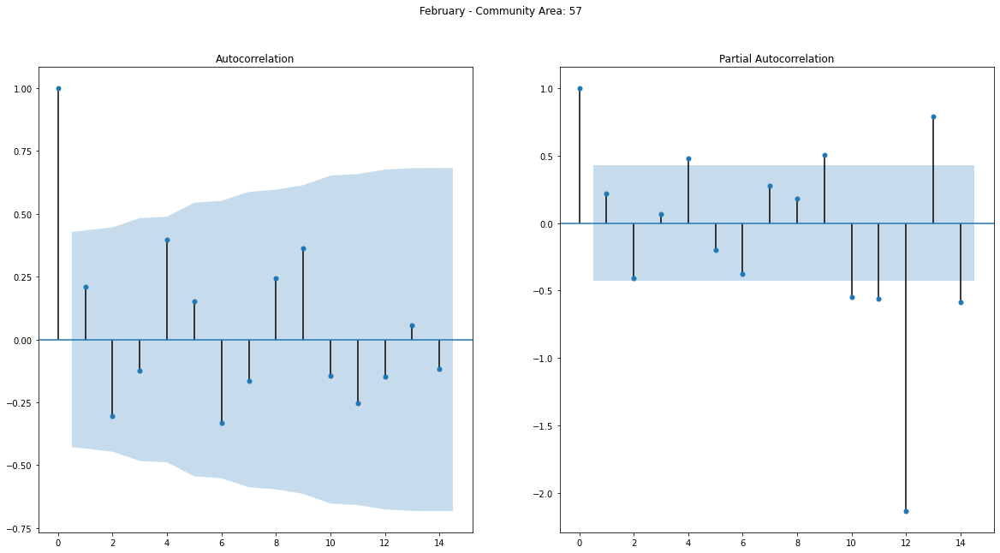

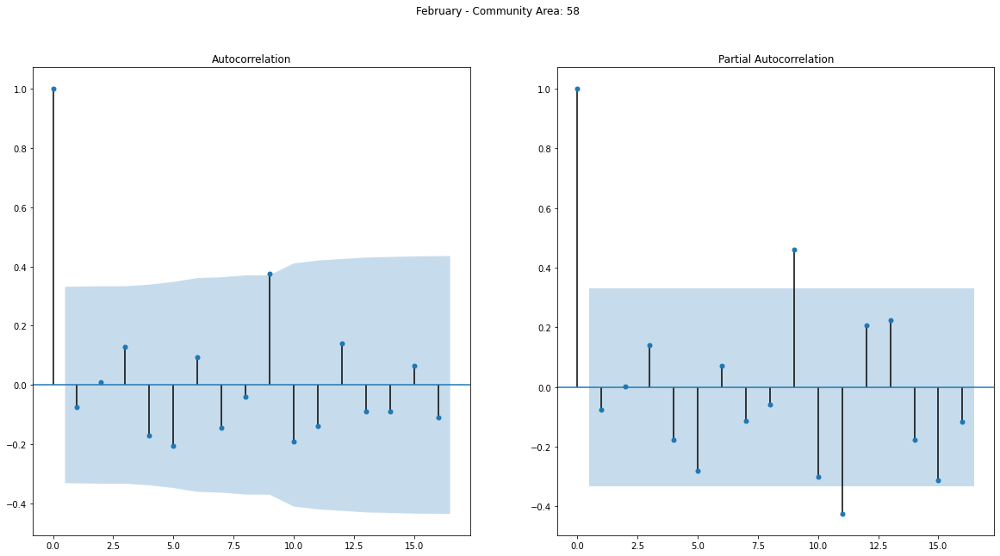

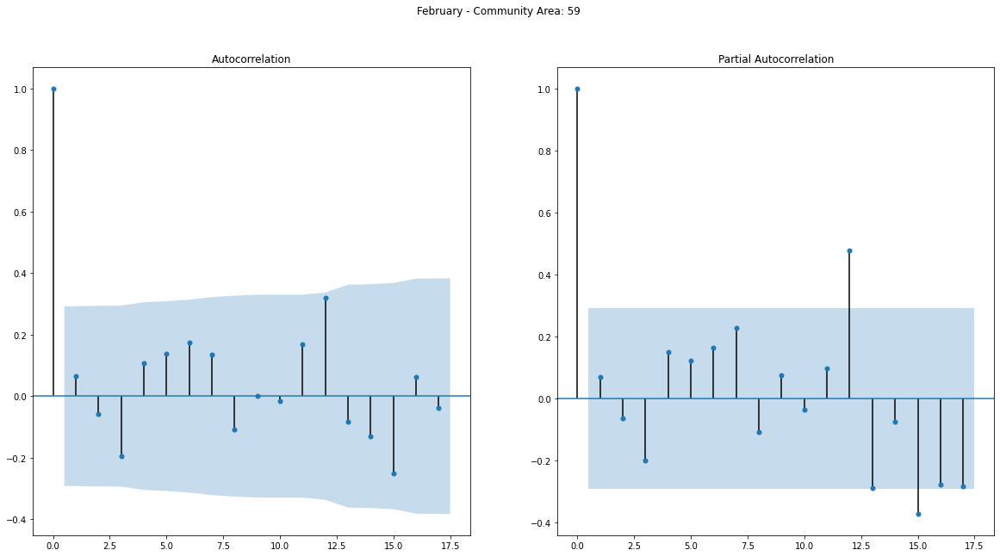

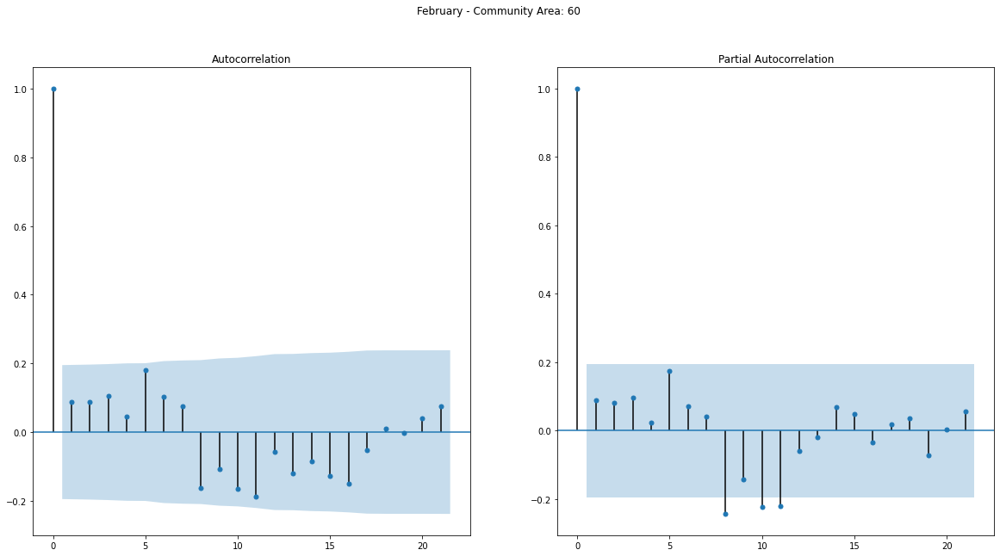

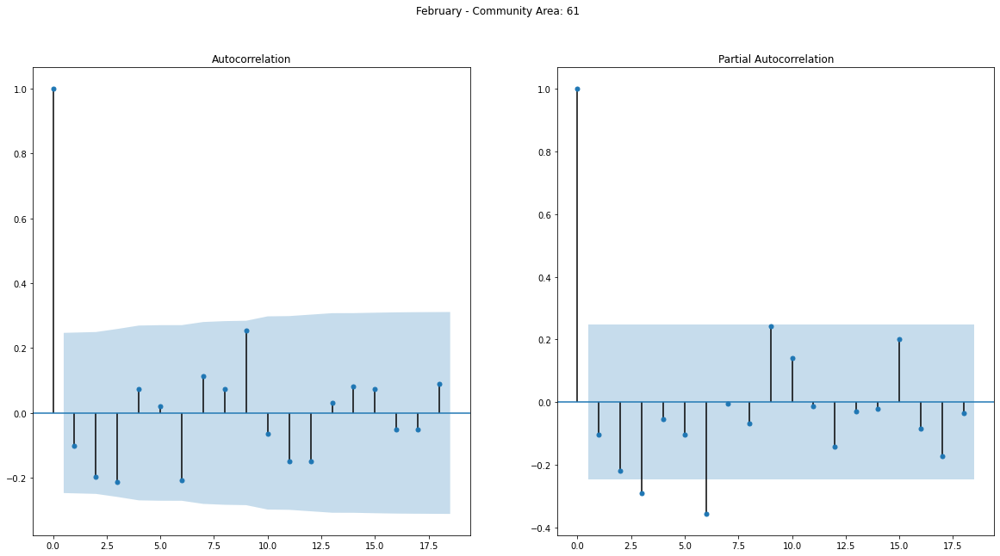

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



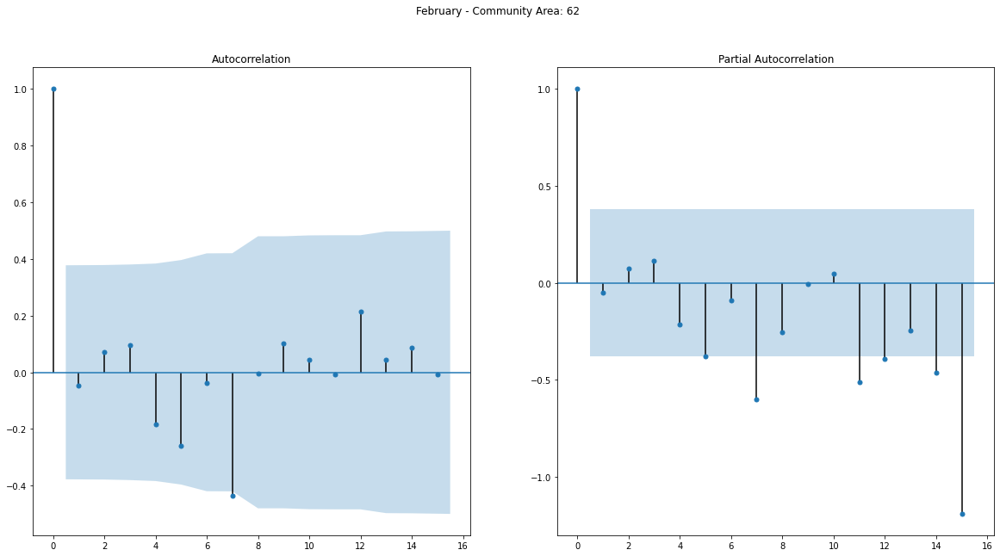

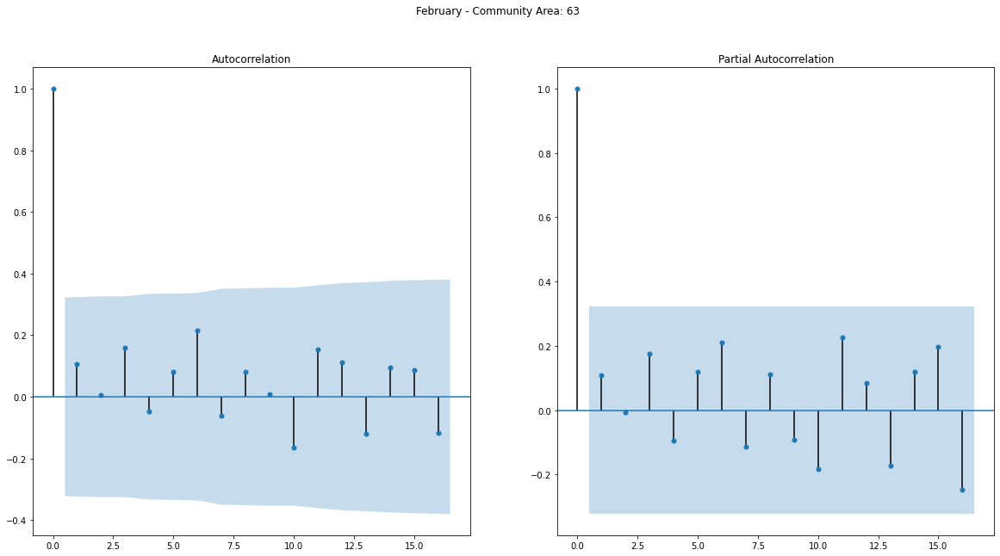

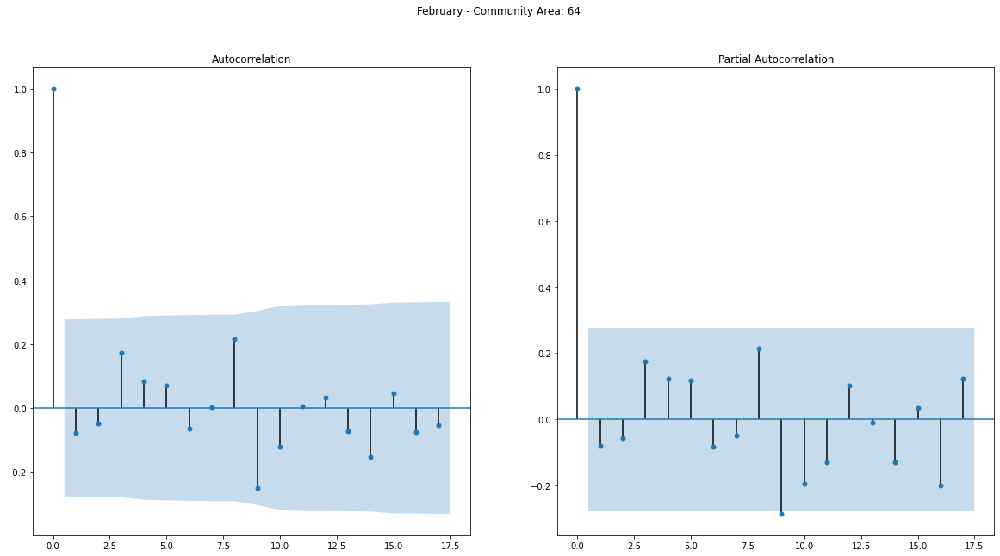

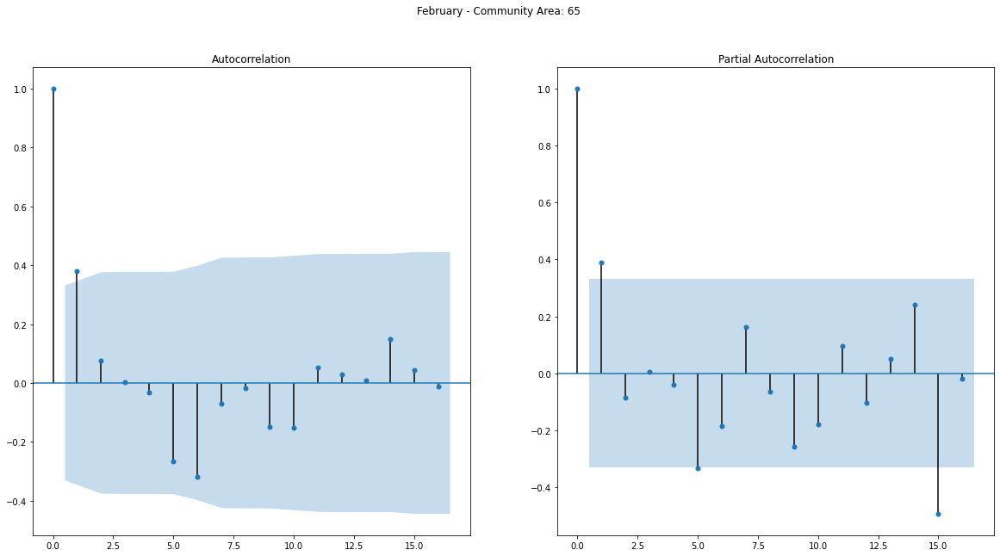

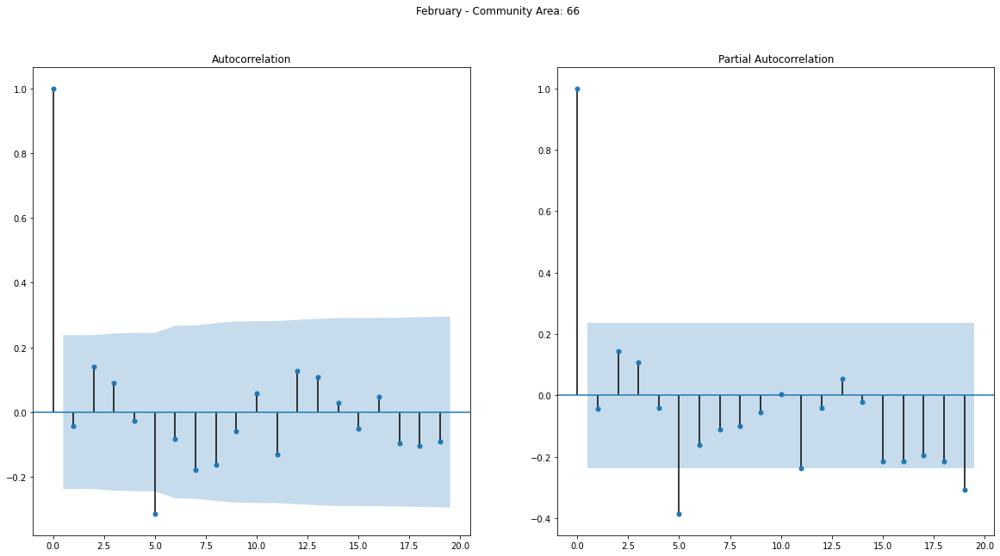

...

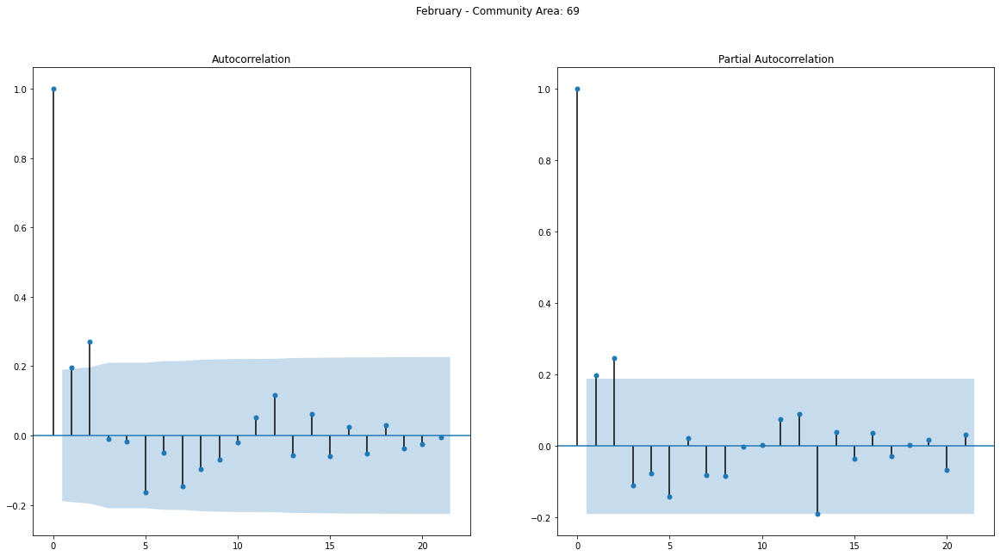

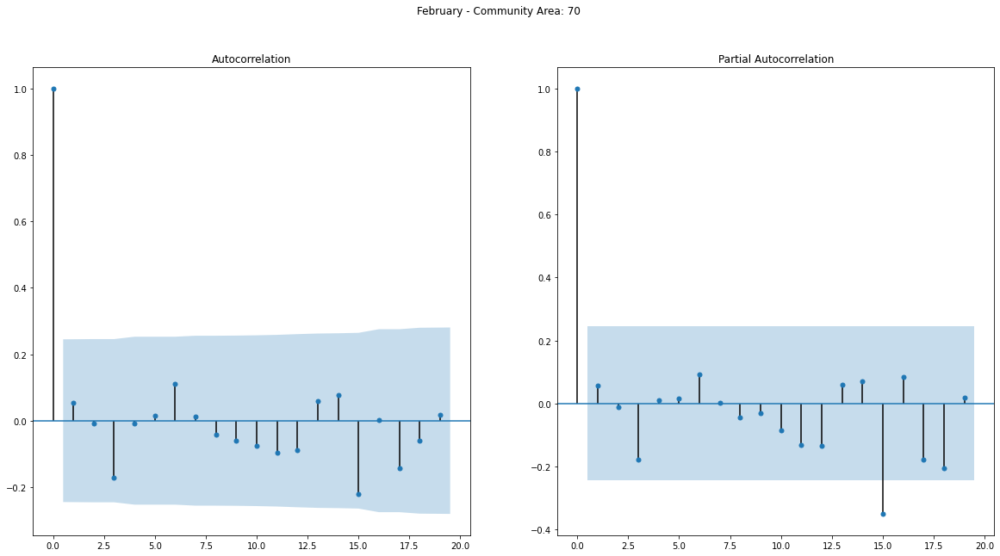

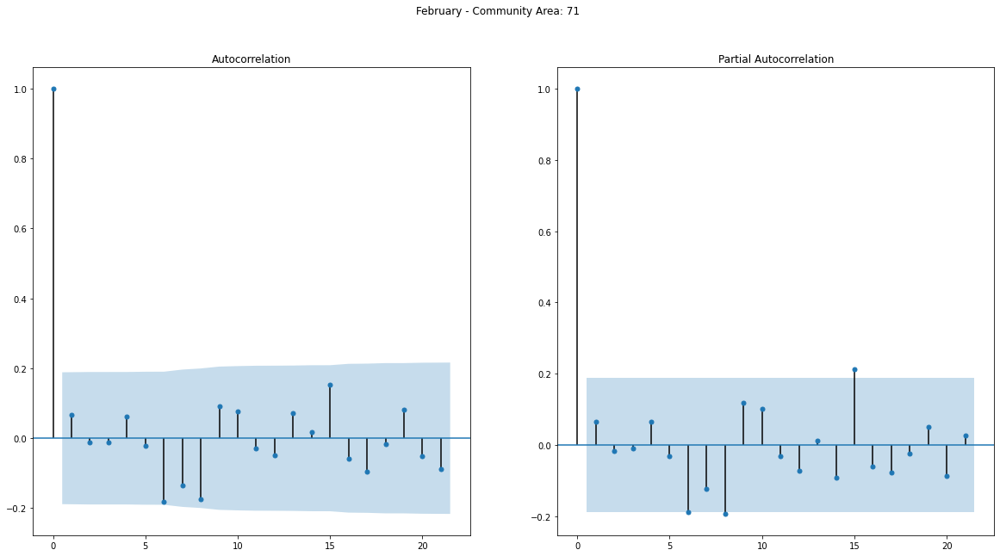

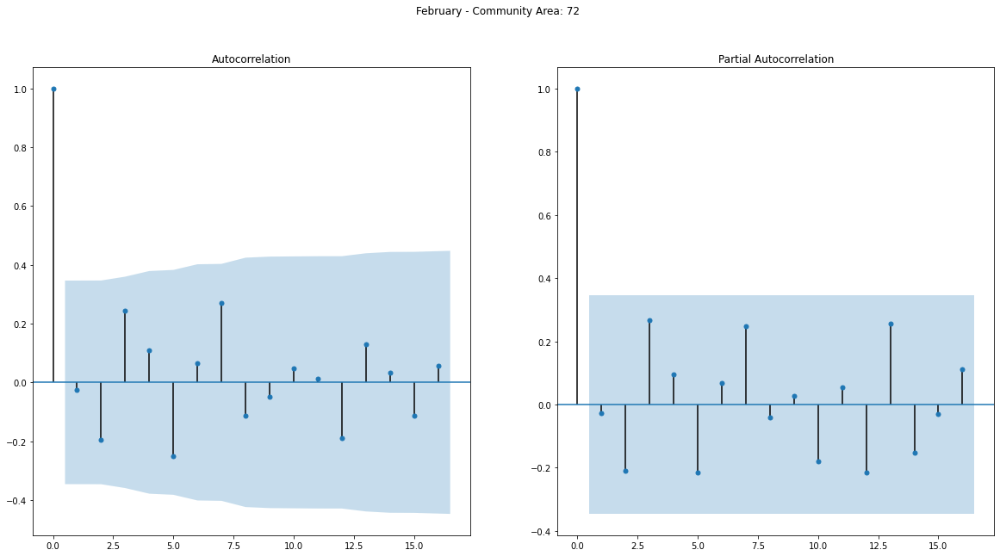

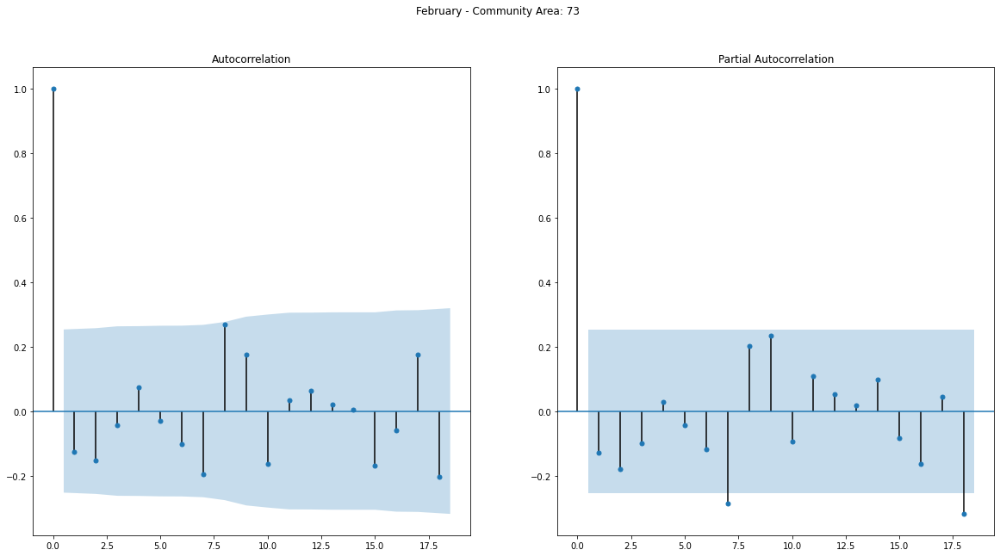

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



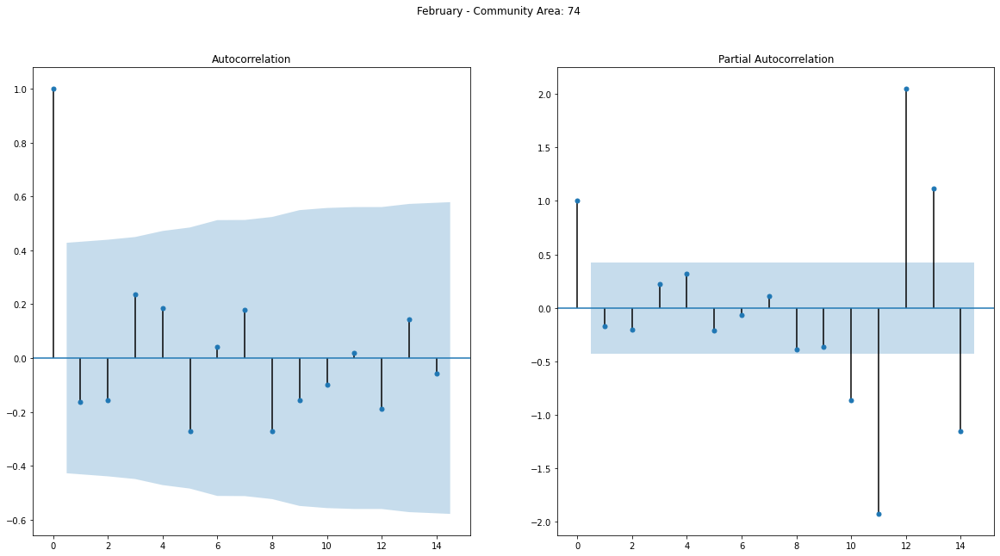

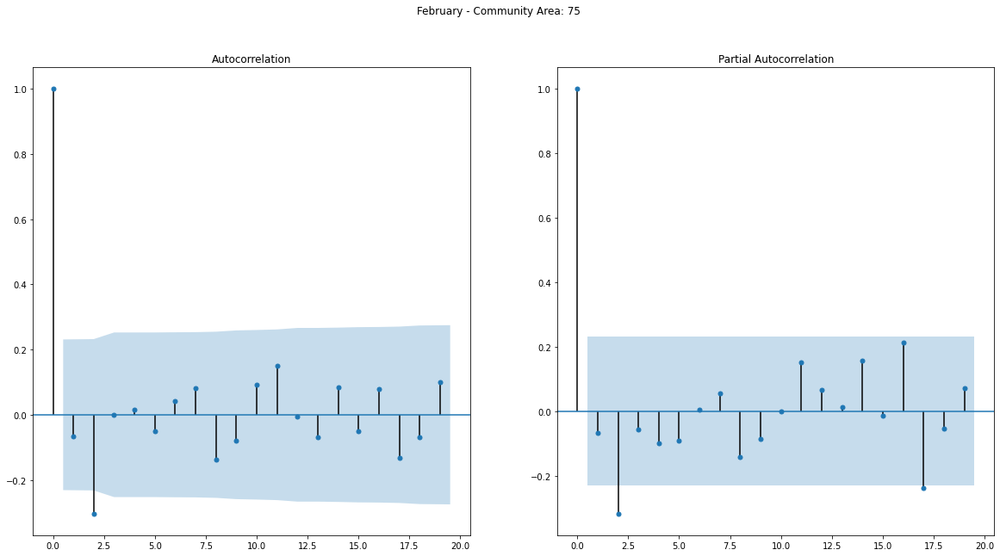

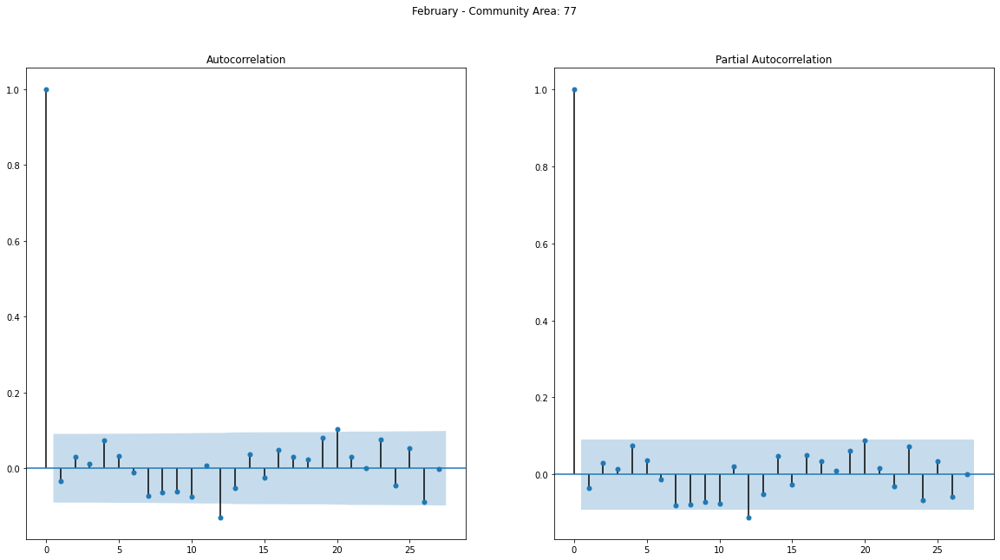

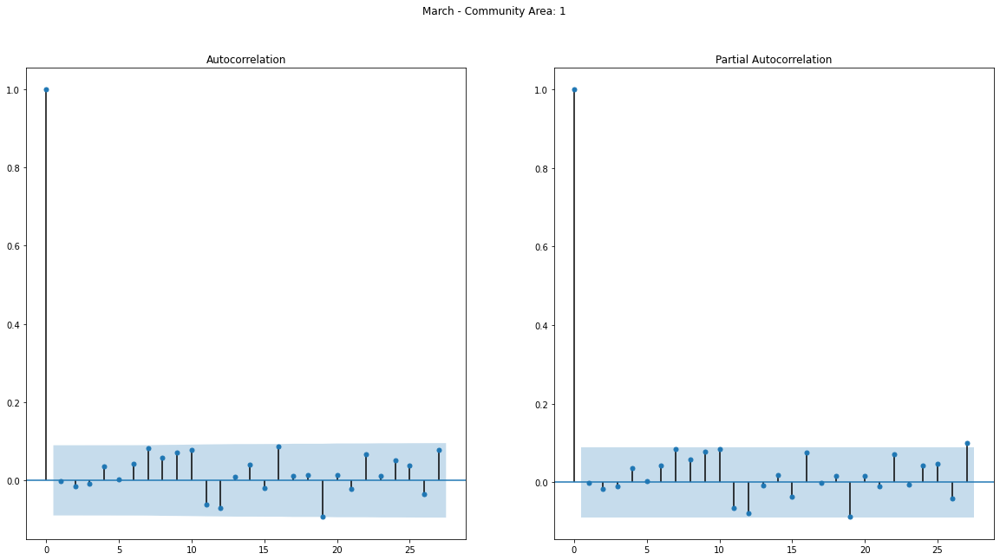

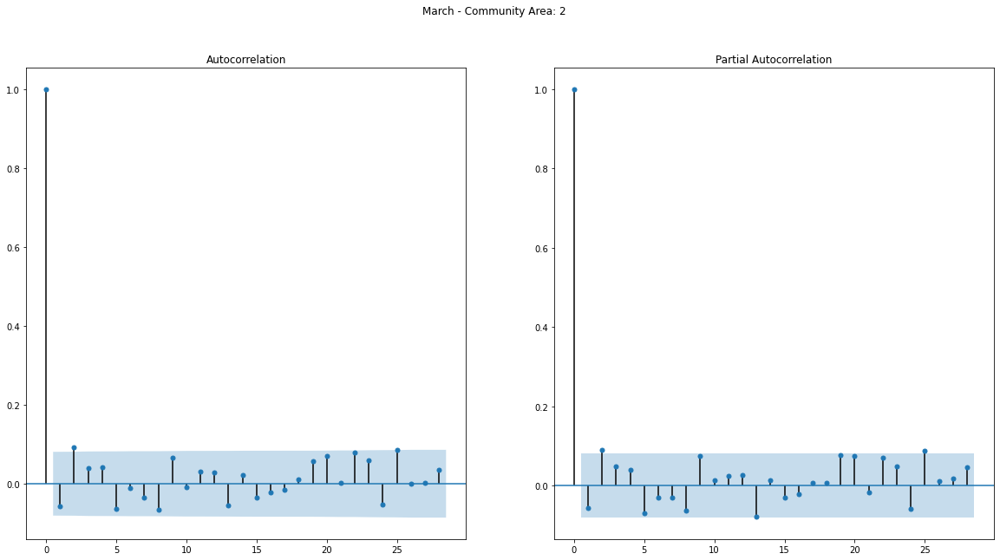

...

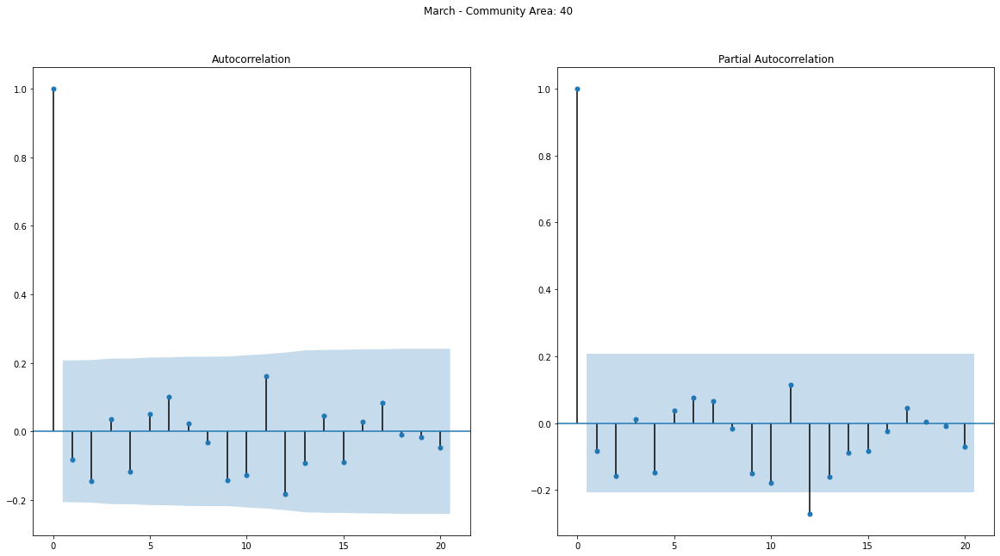

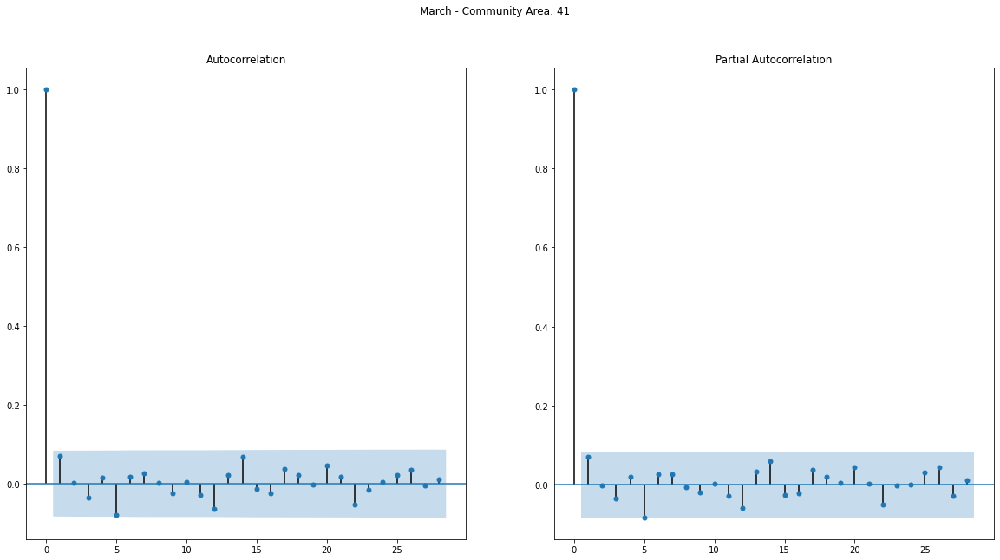

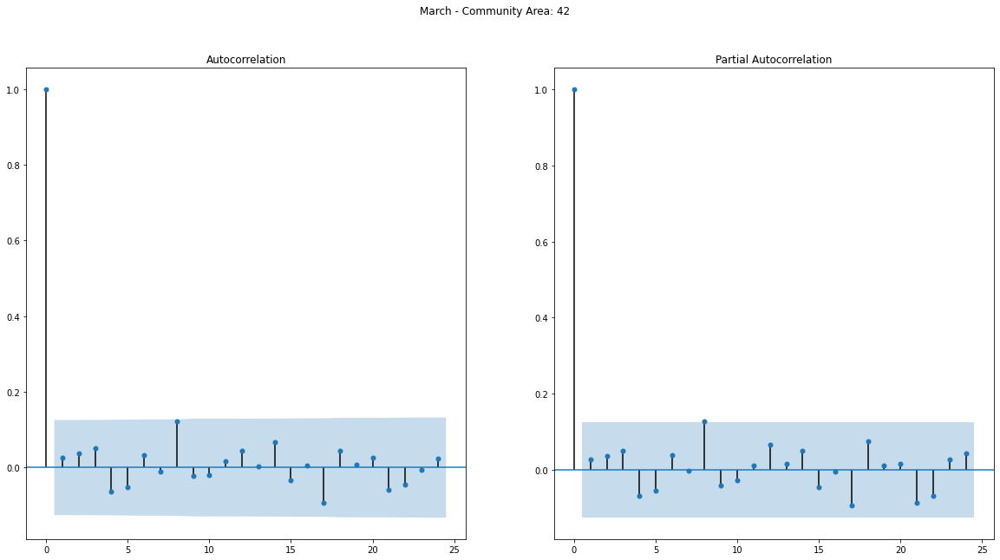

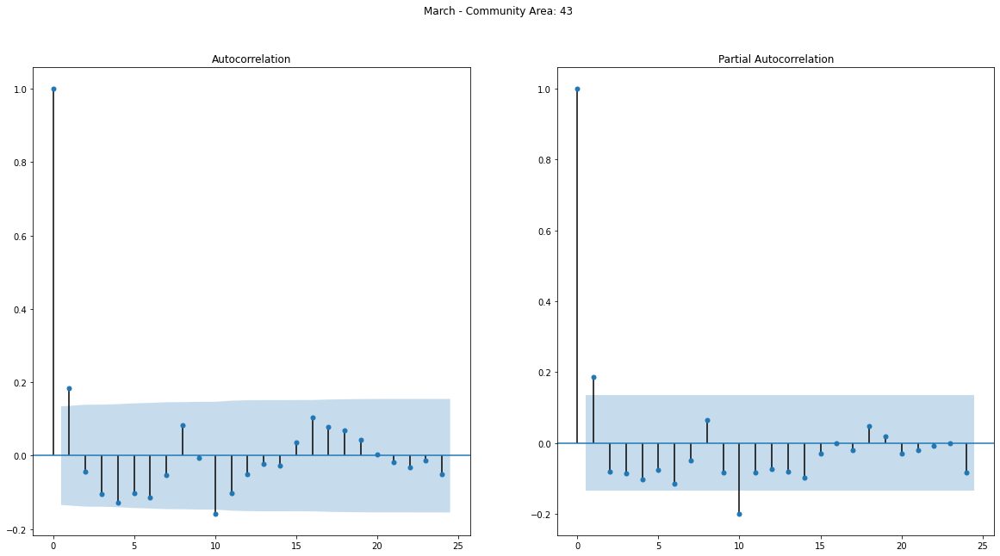

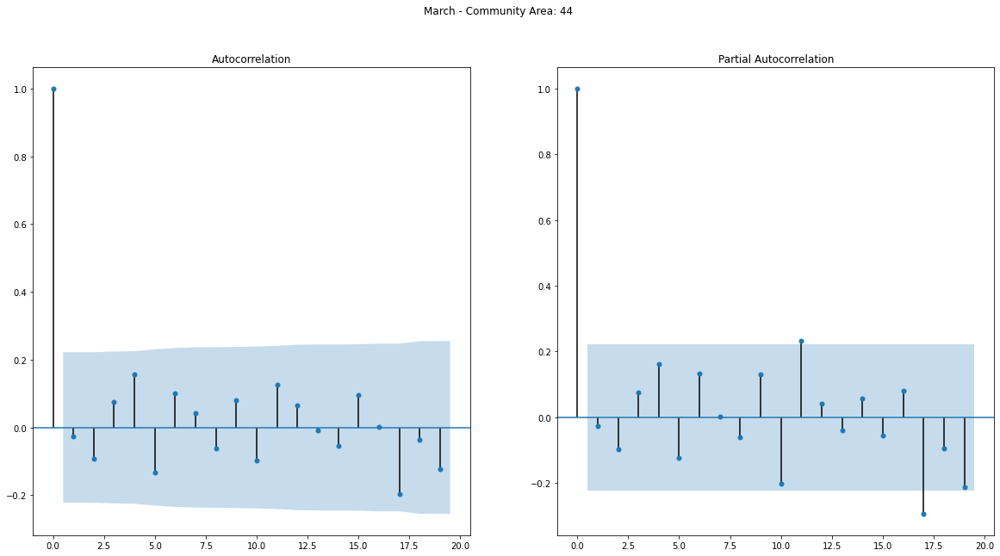

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



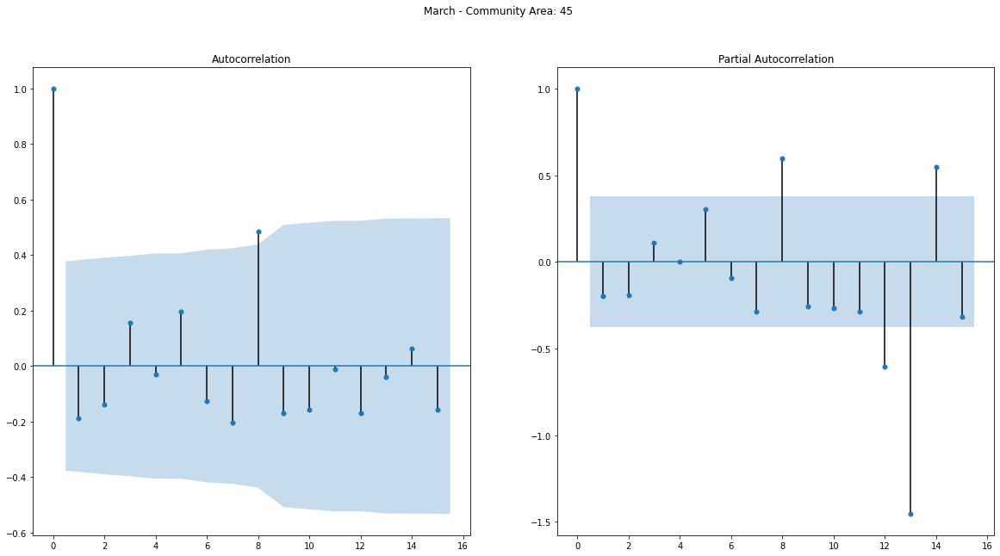

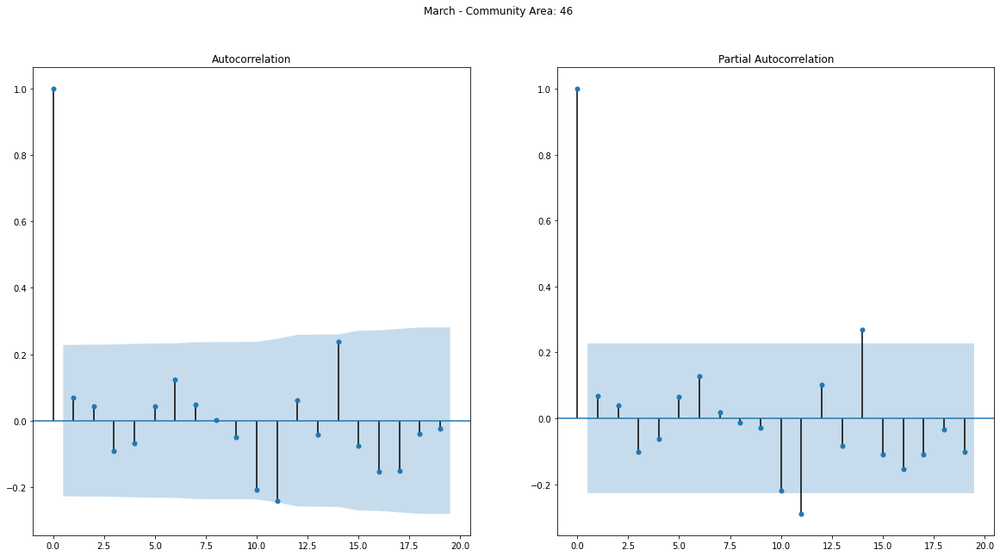

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



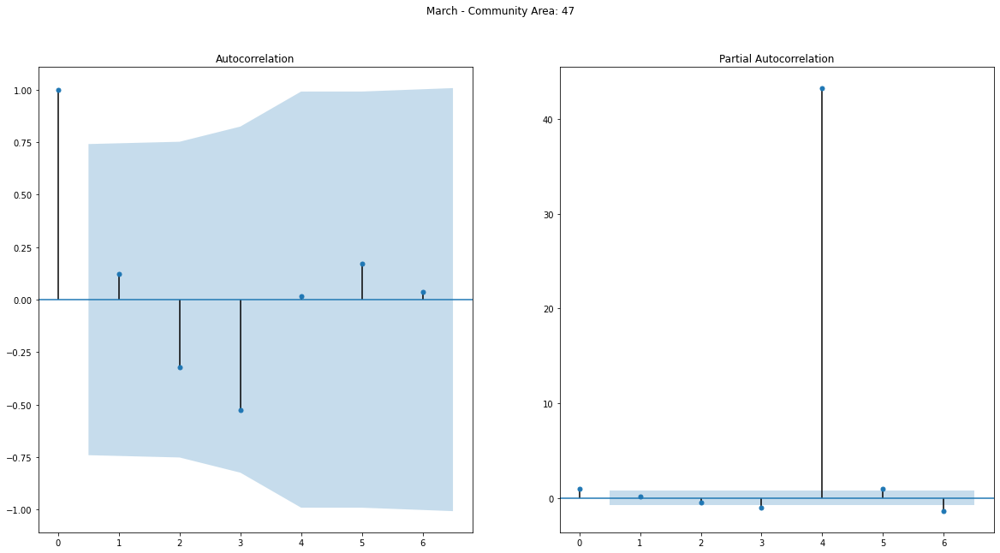

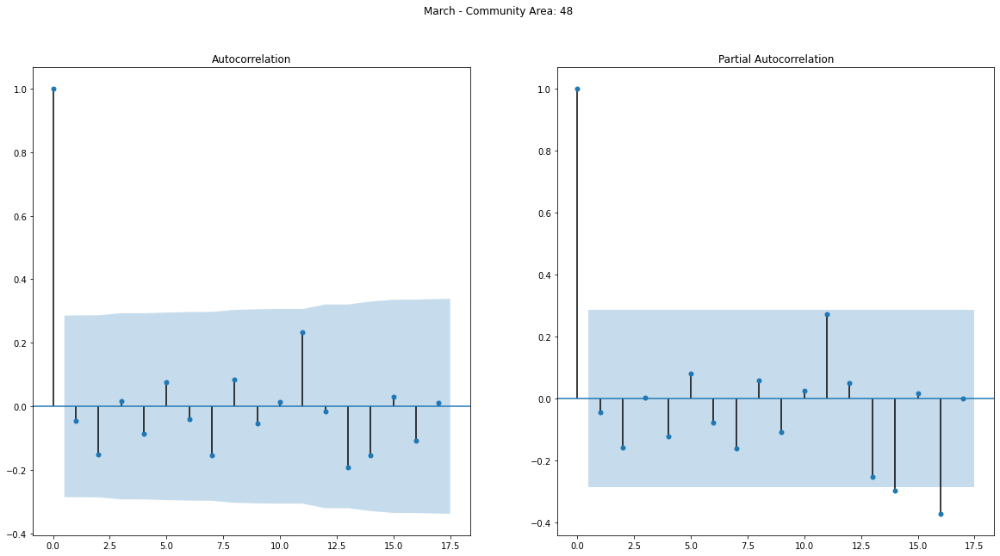

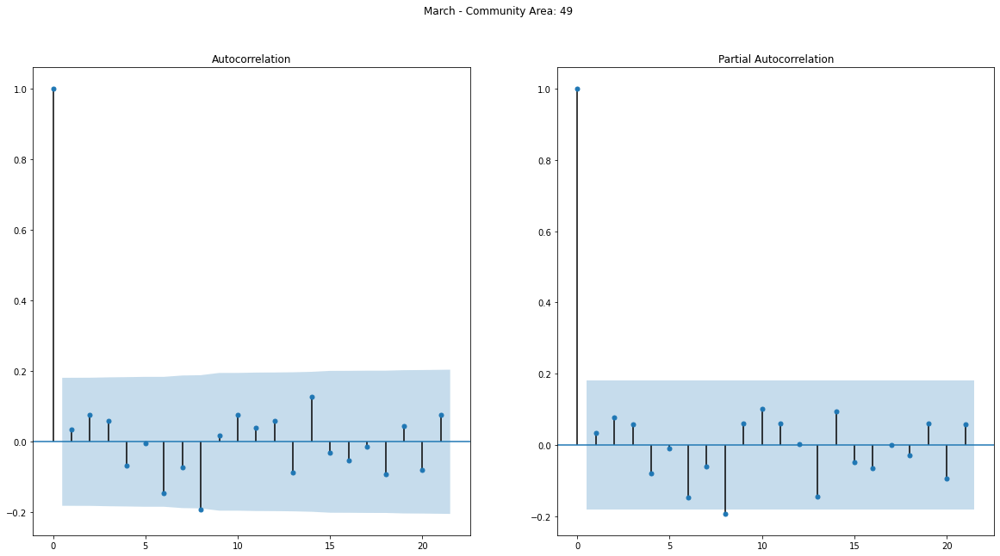

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



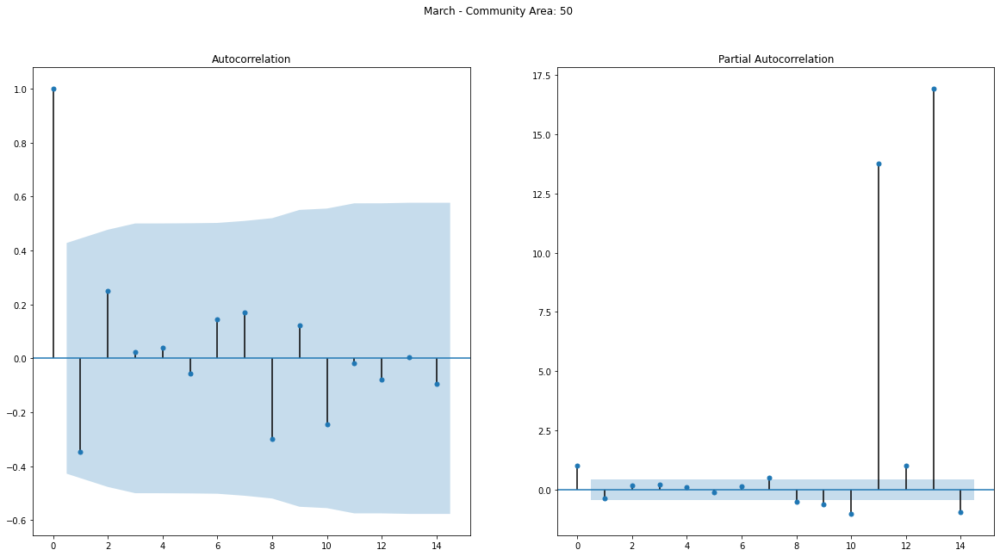

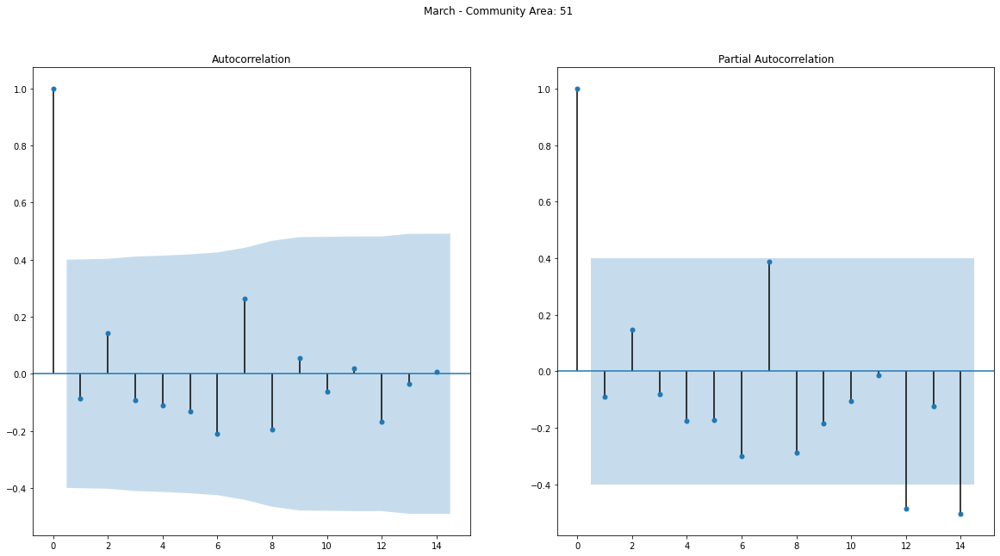

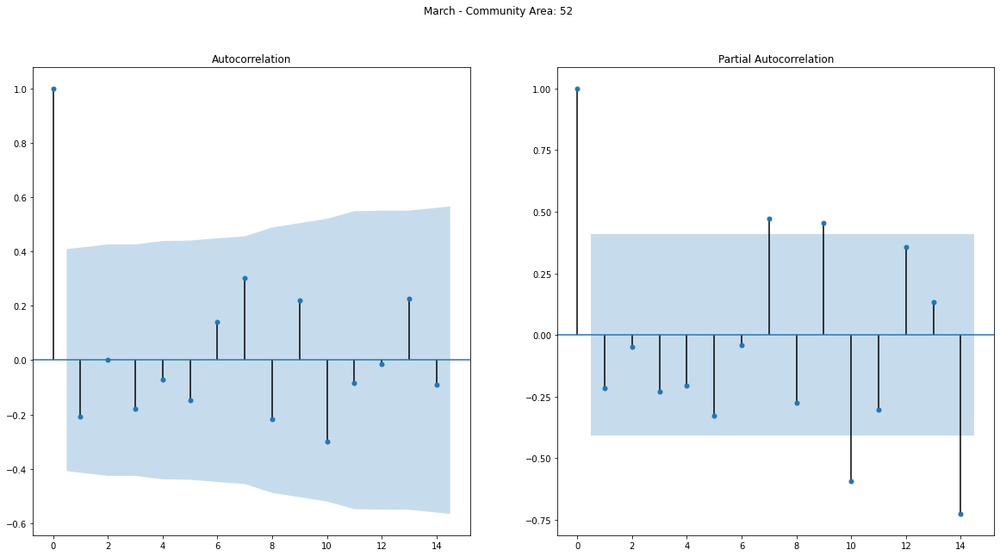

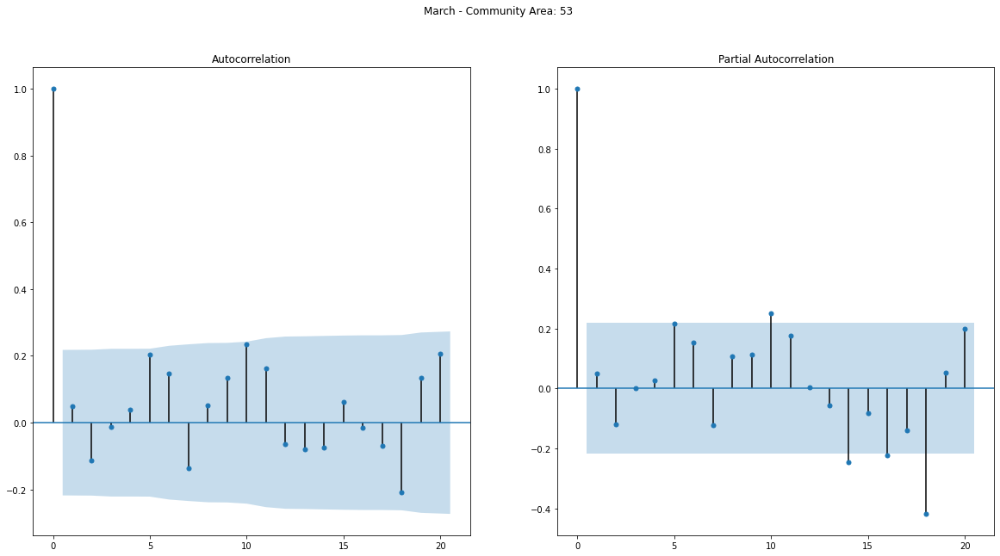

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



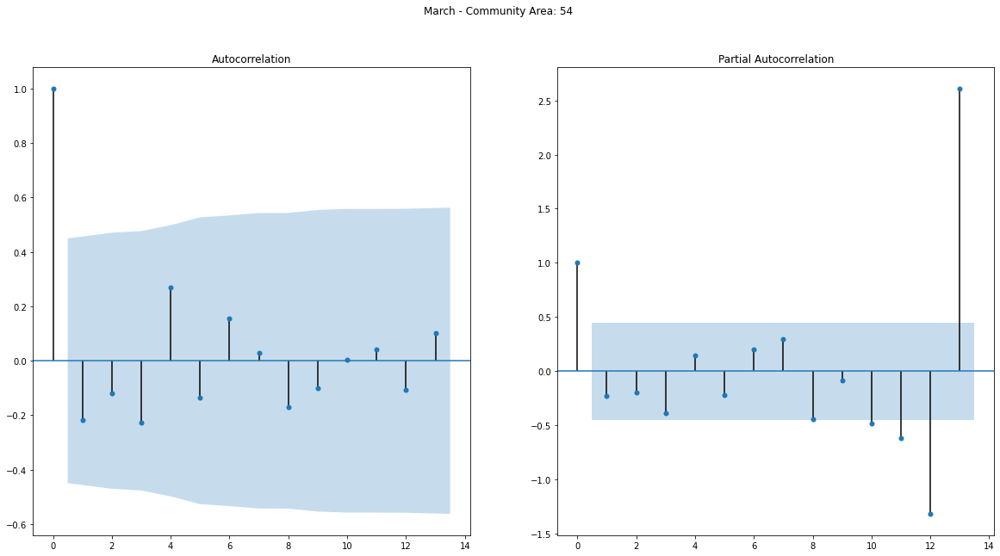

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



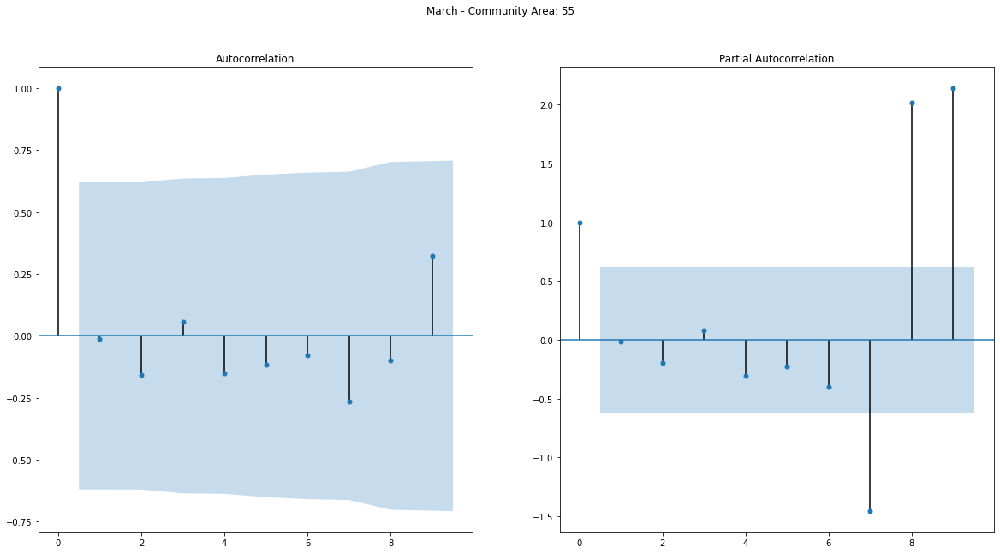

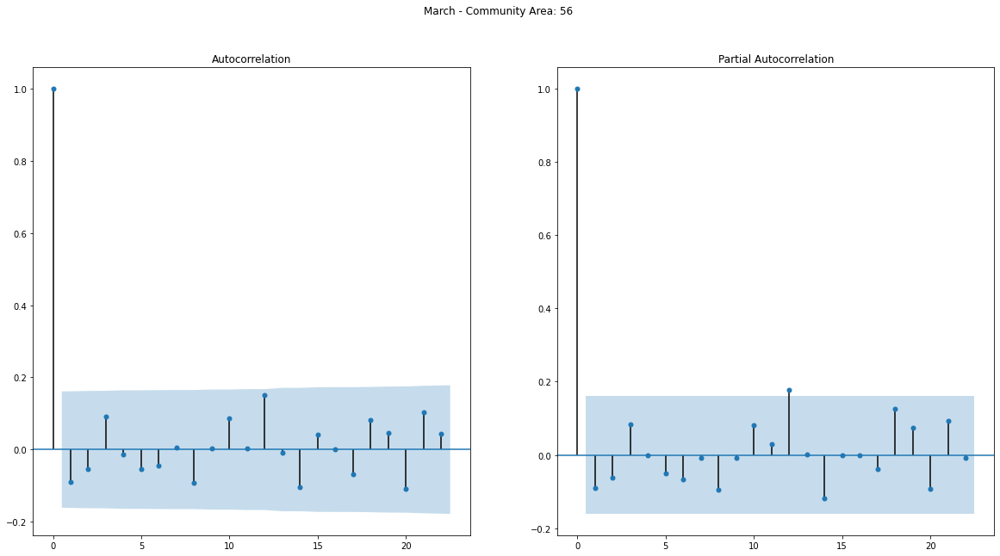

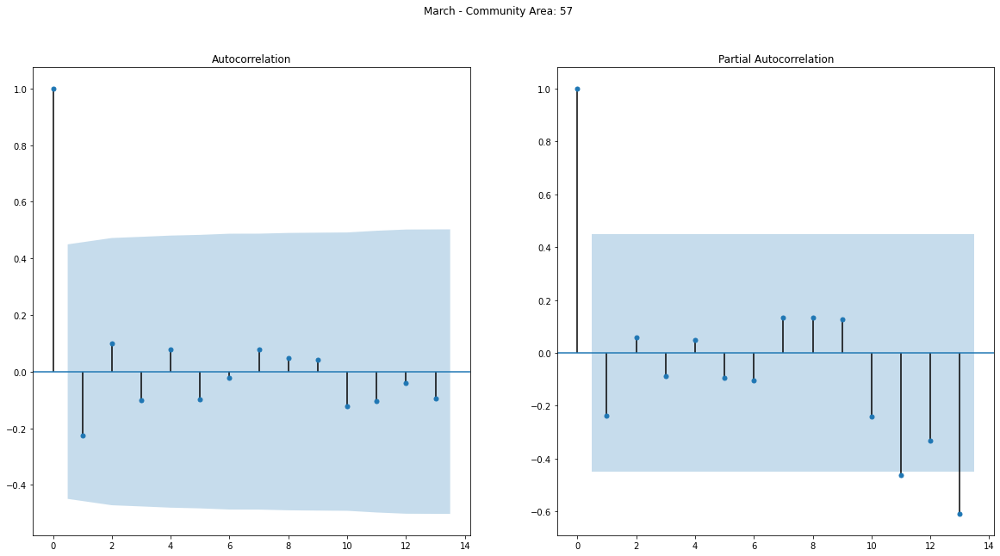

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



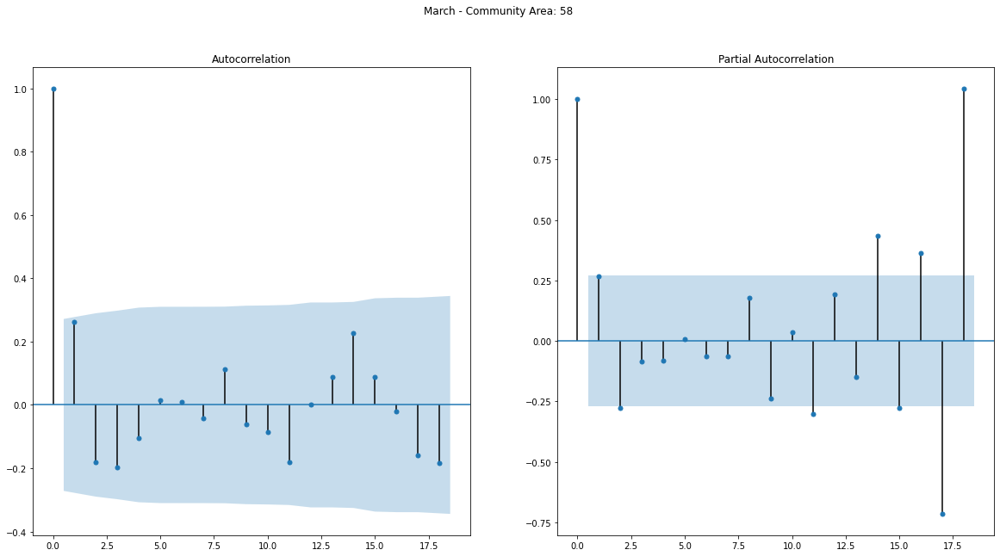

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



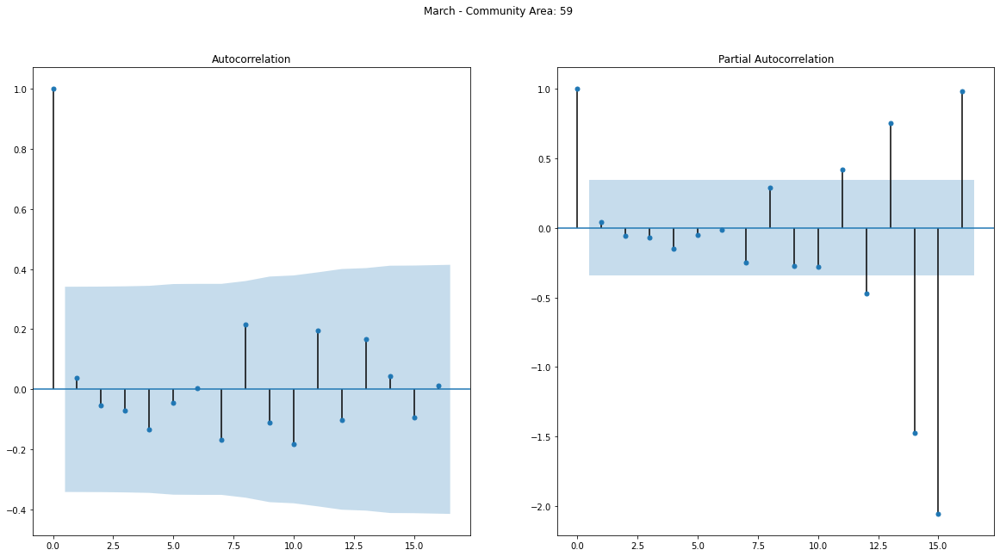

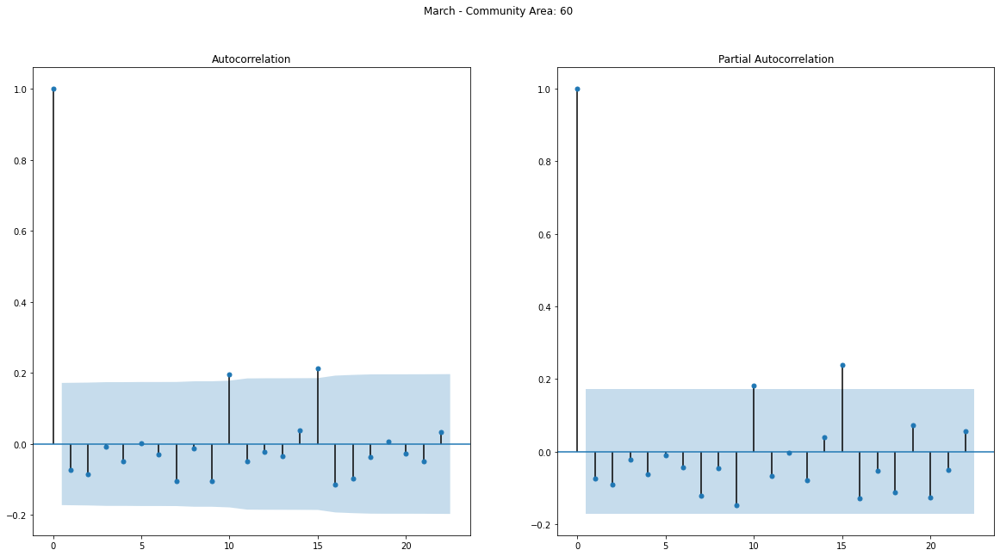

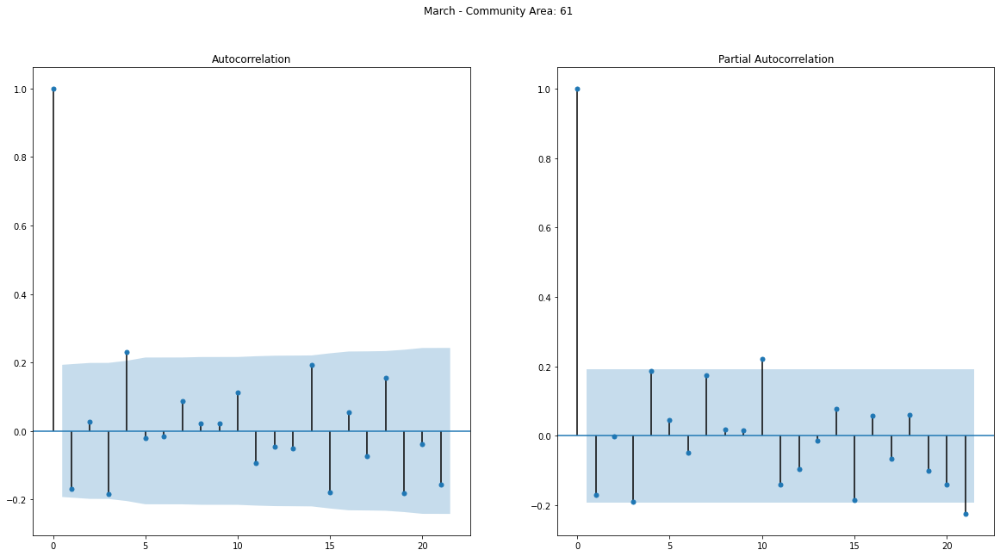

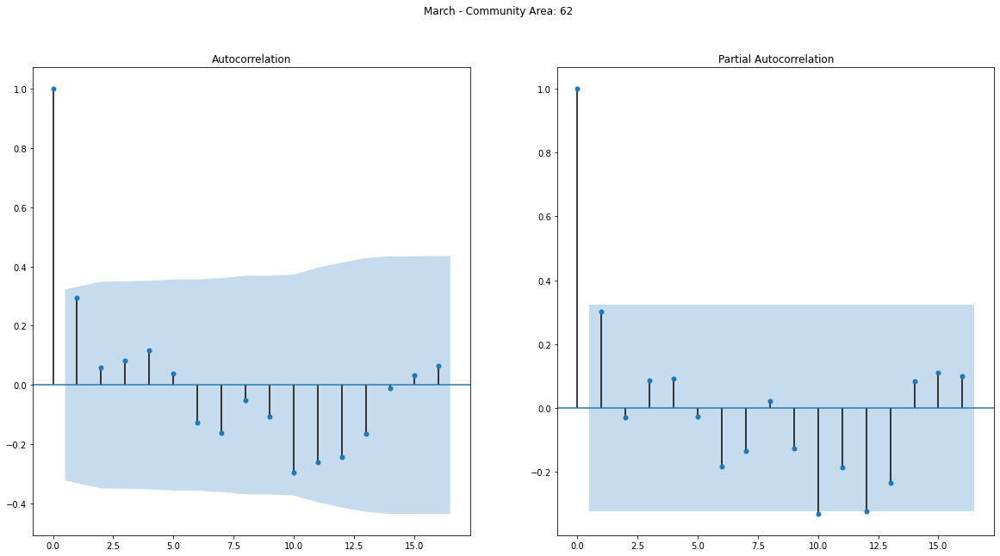

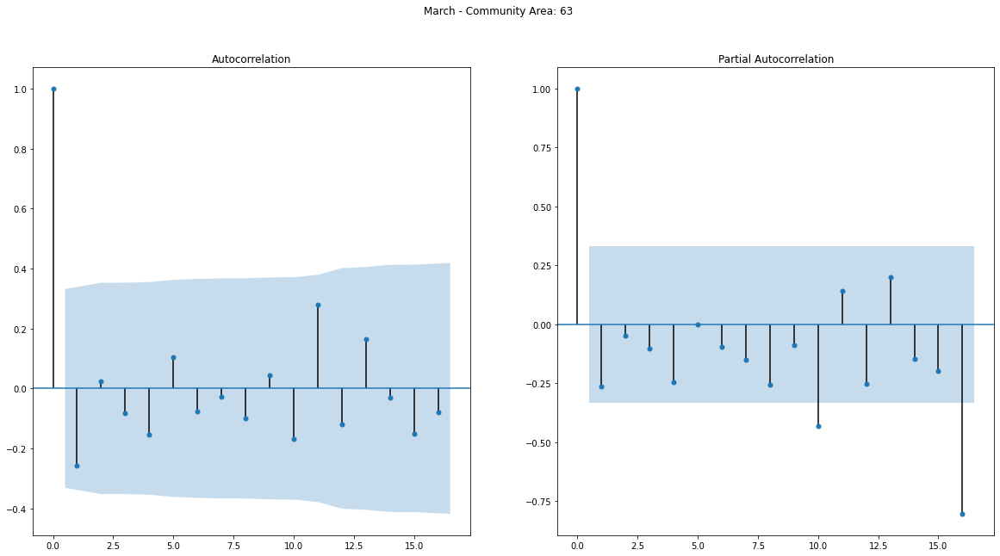

...

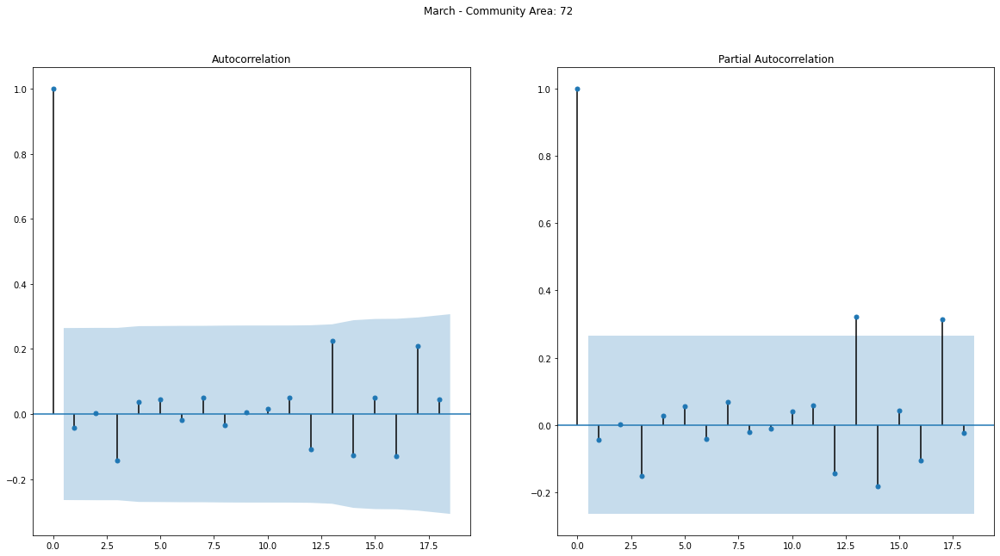

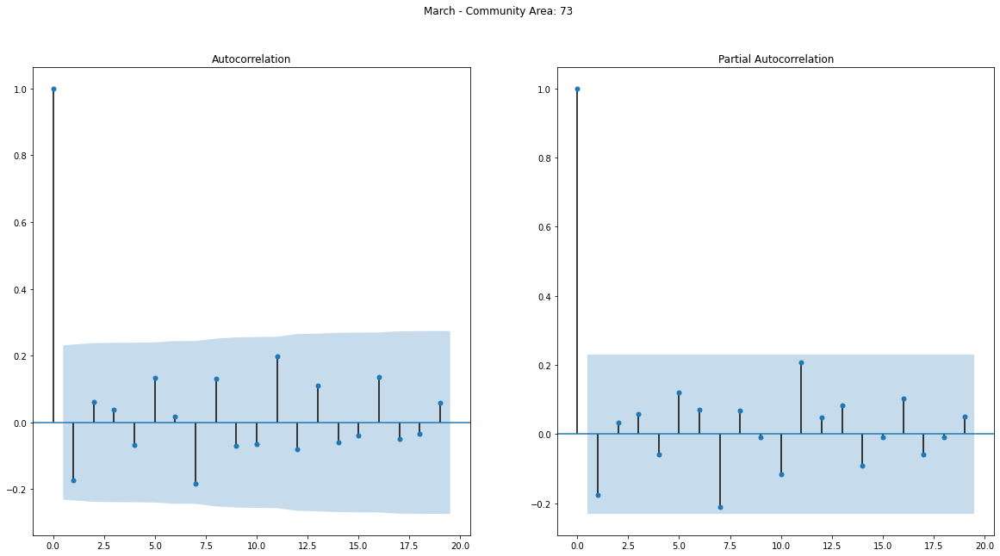

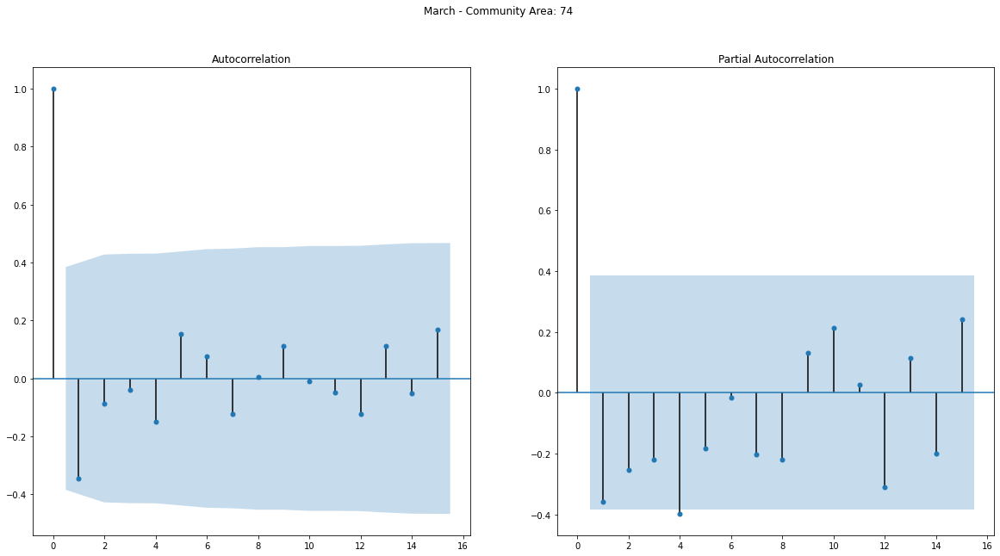

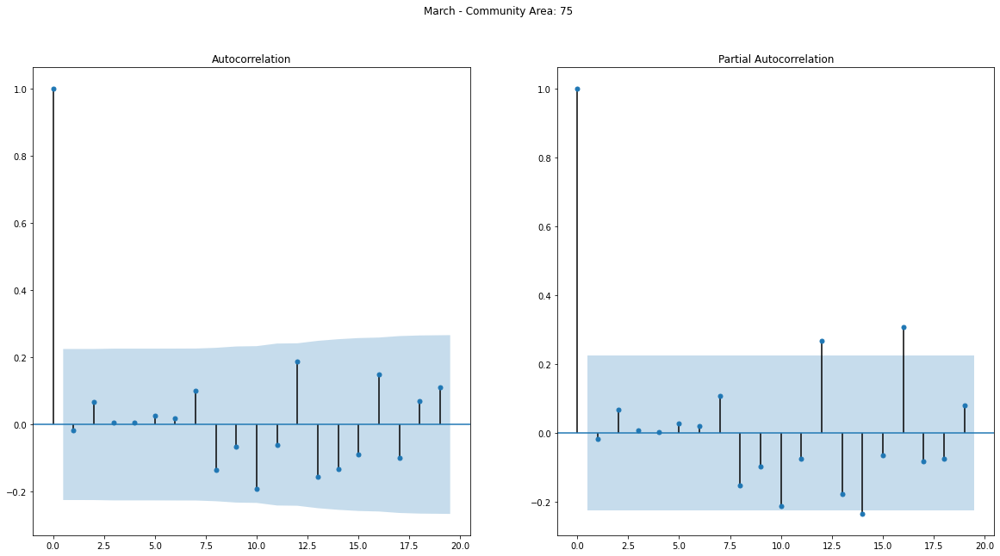

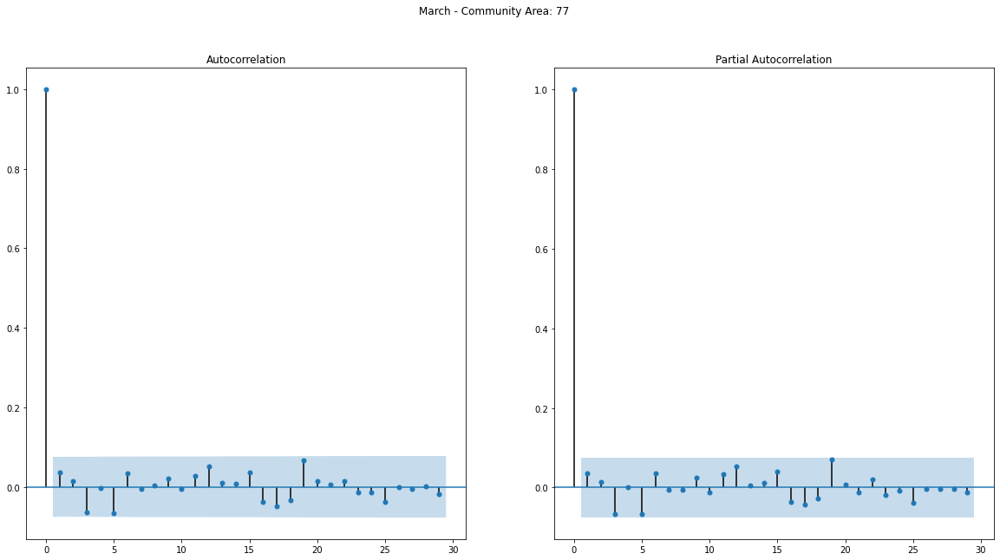

In [ ]:
for ym, df in ohare_21_pu.groupby(['Month', 'DropoffCommunityArea']):
  fig, ax = plt.subplots(figsize=(20, 10))
  fig.suptitle(f'{ym[0]} - Community Area: {ym[1]}')
  plt.subplot(121)
  plot_acf(df['TripRating'], ax=plt.gca())
  plt.subplot(122)
  plot_pacf(df['TripRating'], ax=plt.gca())

  plt.show()

In [ ]:
"""
  Performs an Augmented Dickey Fuller Test and prints the outputs
"""
def fuller(df, v):
  result = adfuller(df[v], autolag='AIC')

  print('ADF Statistic: %f' % result[0])
  print('p-value: %f' % result[1])
  print('Critical Values:')
  for key, value in result[4].items():
	  print('\t%s: %.3f' % (key, value))

def regressor_forecast(rf):
    rf.columns = ['ds', 'y']
    rf_m = Prophet(interval_width=0.95)
    rf_model = rf_m.fit(rf)
    rf_future = rf_m.make_future_dataframe(periods=28, freq='D')
    rf_forecast = rf_m.predict(rf_future)

    return rf_forecast[['ds', 'yhat']]

def trip_rating_forecast(df):
  dfp = df[['TripStartTimestamp', 'TripRating', 'TripSeconds', 'TripMiles', 'DriverPay']]
  dfp.rename(columns={'TripStartTimestamp': 'ds', 'TripRating': 'y'}, inplace=True)

  m = Prophet(interval_width=0.95)    
  model = m.fit(dfp)
  
  def tripseconds(ds):
    date = (pd.to_datetime(ds))
    if dfp[dfp['ds'] == date].empty:
      return tripseconds_future[tripseconds_future['ds'] == date]['yhat'].values[0]
    else:
      return dfp[dfp['ds'] == date]['TripSeconds'].values[0]
    return 0

  tripseconds_future = regressor_forecast(dfp[['ds', 'TripSeconds']])

  def tripmiles(ds):
    date = (pd.to_datetime(ds))
    if dfp[dfp['ds'] == date].empty:
      return tripmiles_future[tripmiles_future['ds'] == date]['yhat'].values[0]
    else:
      return dfp[dfp['ds'] == date]['TripMiles'].values[0]
    return 0

  tripmiles_future = regressor_forecast(dfp[['ds', 'TripMiles']])

  def driverpay(ds):
    date = (pd.to_datetime(ds))
    if dfp[dfp['ds'] == date].empty:
      return driverpay_future[driverpay_future['ds'] == date]['yhat'].values[0]
    else:
      return dfp[dfp['ds'] == date]['DriverPay'].values[0]
    return 0

  driverpay_future = regressor_forecast(dfp[['ds', 'DriverPay']])

  future = m.make_future_dataframe(periods=28, freq='D')
  future['TripSeconds'] = future['ds'].apply(tripseconds)
  future['TripMiles'] = future['ds'].apply(tripmiles)
  future['DriverPay'] = future['ds'].apply(driverpay)
  forecast = m.predict(future)
  growth = round((forecast.iloc[-1]['yhat'] - float(forecast.iloc[0]['yhat'])) / float(forecast.iloc[0]['yhat']), 2)
  # range = round((forecast.iloc[-1]['yhat_upper'] - forecast.iloc[-1]['yhat_lower']) / forecast.iloc[-1]['yhat'], 2)
  return {
      'model': m,
      'forecast': forecast,
      'growth': growth,
      # 'range': range
  }

def rating_viz(df, group, title=''):
  fig, ax = plt.subplots(figsize=(25,10))
  fig.autofmt_xdate()
  plt.title(f'{title}', size=24)
  
  for g, df in df.groupby(group):
    sns.scatterplot(x='TripStartTimestamp', y='TripRating', linewidth=1.5, label=f'{g}', data=df)
    
  plt.legend(loc='upper left')

  plt.show()

In [ ]:
pu_forecasts = {}

for area, df in ohare_21_do.groupby(['PickupCommunityArea']):
  pu_forecasts[area] = trip_rating_forecast(df)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-v

In [ ]:
growth_df = pd.DataFrame(columns=['PickupCommunityArea', 'Growth'])
for comm in pu_forecasts.keys():
  growth_df = growth_df.append({'PickupCommunityArea': comm, 'Growth': pu_forecasts[comm]['growth']}, ignore_index=True)

growth_df.head()

,PickupCommunityArea,Growth
0,1.0,-0.12
1,2.0,-0.17
2,3.0,-0.02
3,4.0,0.11
4,5.0,0.06


In [ ]:
avg_growth = growth_df['Growth'].mean()

upandcomers = {}

for comm in pu_forecasts.keys():
  if pu_forecasts[comm]['growth'] >= avg_growth:
    upandcomers[comm] = pu_forecasts[comm]

In [ ]:
print(len(upandcomers))

34


In [ ]:
trip_model = upandcomers[25]['model']
trip_forecast = upandcomers[25]['forecast']

In [ ]:
trip_forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
1154,2021-04-24 18:00:00,1.409906,0.623134,2.155851,1.305303,1.507009,0.019844,0.019844,0.019844,-0.031815,-0.031815,-0.031815,0.051659,0.051659,0.051659,0.0,0.0,0.0,1.429751
1155,2021-04-25 18:00:00,1.420593,0.646094,2.150754,1.310673,1.522575,-0.011246,-0.011246,-0.011246,-0.031815,-0.031815,-0.031815,0.020568,0.020568,0.020568,0.0,0.0,0.0,1.409346
1156,2021-04-26 18:00:00,1.431279,0.650970,2.186068,1.312496,1.538519,0.003803,0.003803,0.003803,-0.031815,-0.031815,-0.031815,0.035617,0.035617,0.035617,0.0,0.0,0.0,1.435082
1157,2021-04-27 18:00:00,1.441965,0.556043,2.081383,1.317149,1.554668,-0.108034,-0.108034,-0.108034,-0.031815,-0.031815,-0.031815,-0.076220,-0.076220,-0.076220,0.0,0.0,0.0,1.333931
1158,2021-04-28 18:00:00,1.452652,0.585662,2.115771,1.319587,1.571624,-0.070166,-0.070166,-0.070166,-0.031815,-0.031815,-0.031815,-0.038351,-0.038351,-0.038351,0.0,0.0,0.0,1.382486


In [ ]:
from fbprophet.plot import plot_plotly, add_changepoints_to_plot

In [ ]:
fig = plot_plotly(trip_model, trip_forecast)
fig

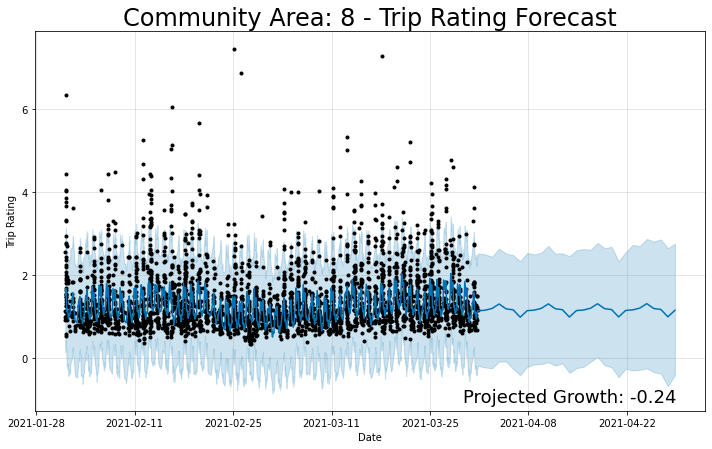

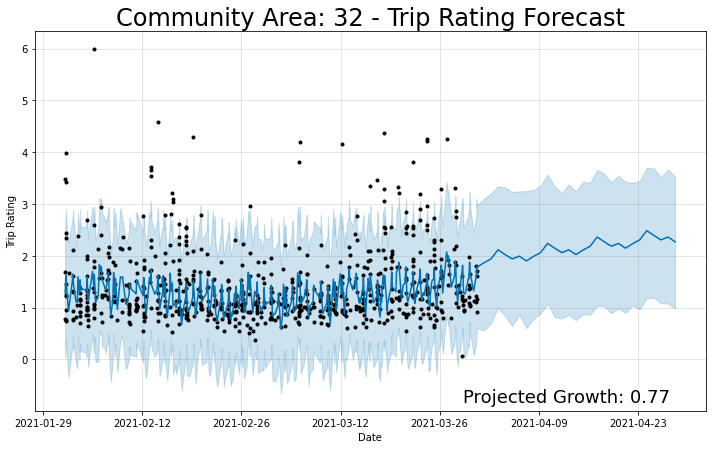

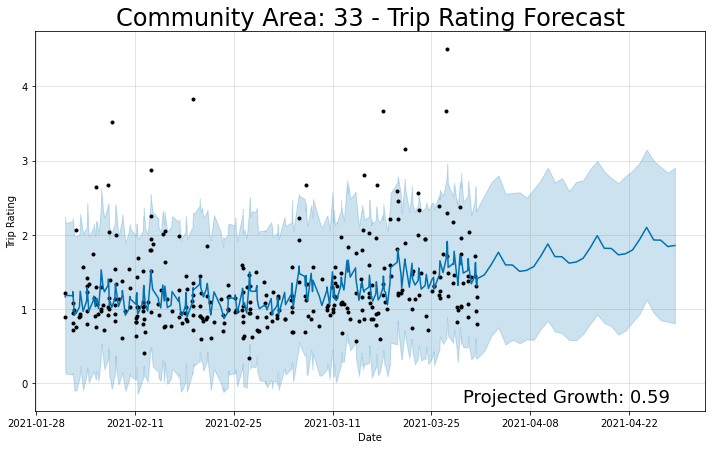

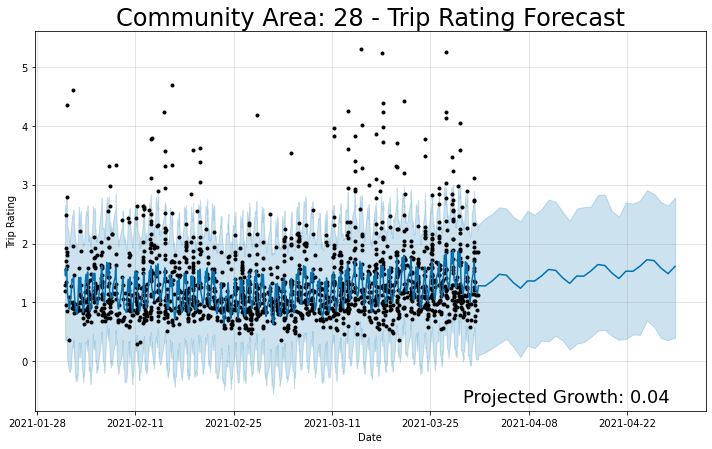

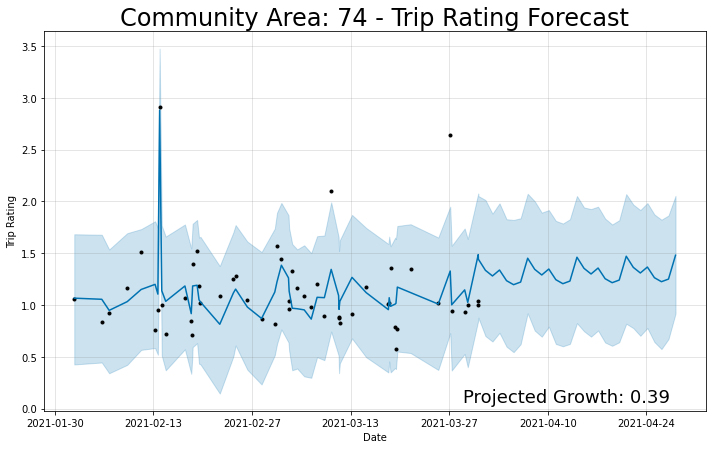

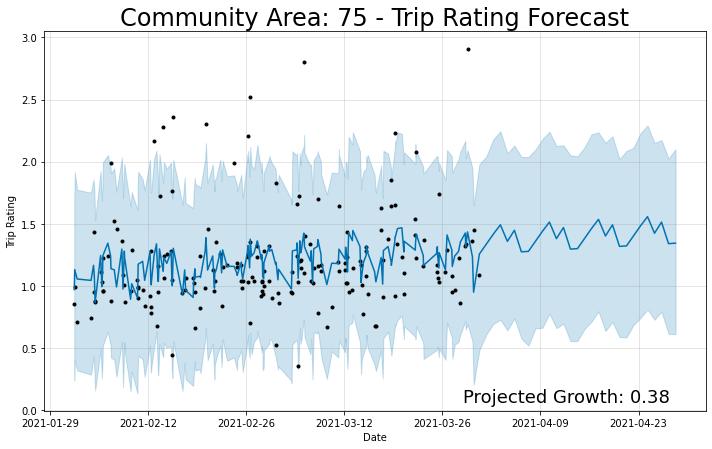

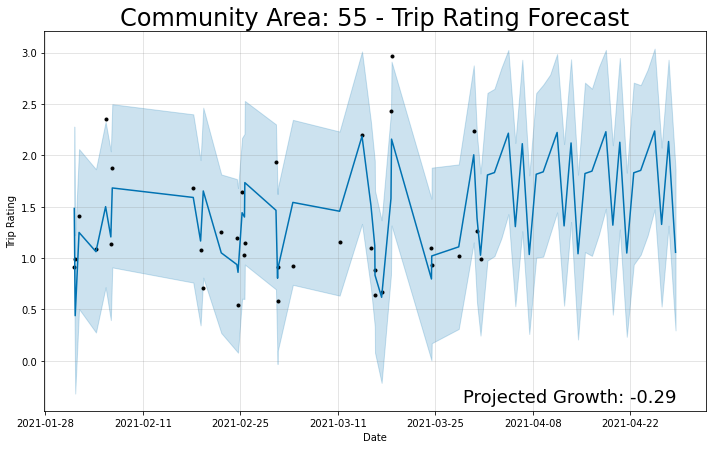

In [ ]:
plot_list = [8, 32, 33, 28, 74, 75, 55]

for area in plot_list:
  print('\n')
  m = pu_forecasts[area]['model']
  forecast = pu_forecasts[area]['forecast']

  fig = m.plot(forecast, xlabel='Date', ylabel='Trip Rating')
  proj_growth = f'Projected Growth: {pu_forecasts[area]["growth"]}'
  plt.annotate(s=proj_growth,
            xy=(0.65, .135), xycoords='figure fraction',
            horizontalalignment='left', verticalalignment='top',
            fontsize=18)
  ax = fig.gca()
  ax.set_title(f'Community Area: {area} - Trip Rating Forecast', size=24)
  plt.show()

In [ ]:
do_forecasts = {}

for area, df in ohare_21_pu.groupby(['DropoffCommunityArea']):
  do_forecasts[area] = trip_rating_forecast(df)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-v

In [ ]:
growth_df = pd.DataFrame(columns=['DropoffCommunityArea', 'Growth'])
for comm in do_forecasts.keys():
  growth_df = growth_df.append({'DropoffCommunityArea': comm, 'Growth': do_forecasts[comm]['growth']}, ignore_index=True)

growth_df.head()

,DropoffCommunityArea,Growth
0,1.0,0.02
1,2.0,0.04
2,3.0,-0.19
3,4.0,-0.17
4,5.0,-0.16


In [ ]:
avg_growth = growth_df['Growth'].mean()

upandcomers = {}

for comm in do_forecasts.keys():
  if do_forecasts[comm]['growth'] >= avg_growth:
    upandcomers[comm] = do_forecasts[comm]

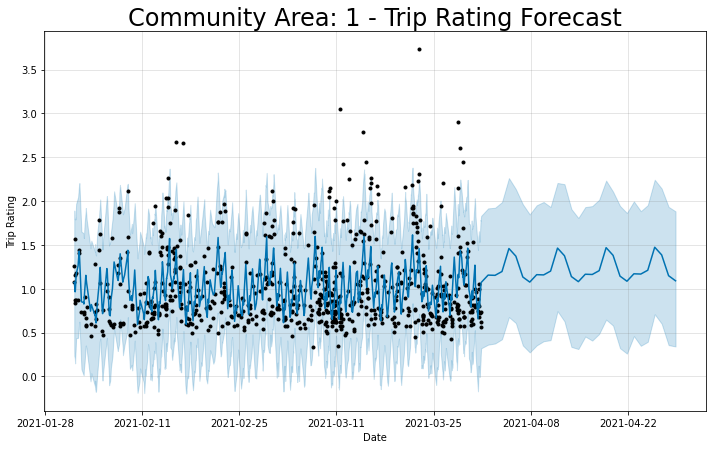

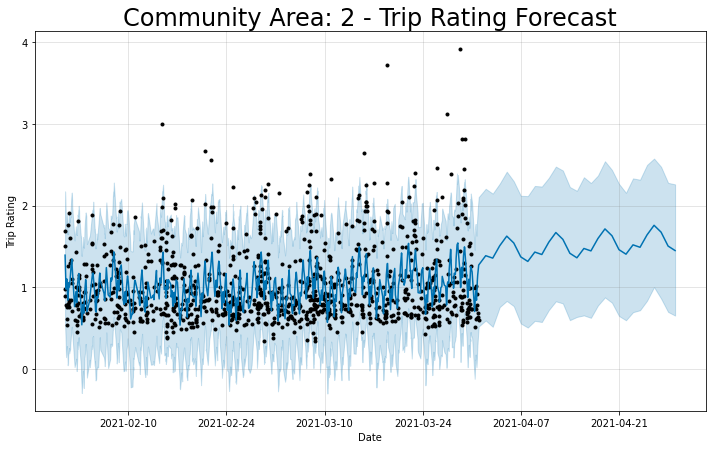

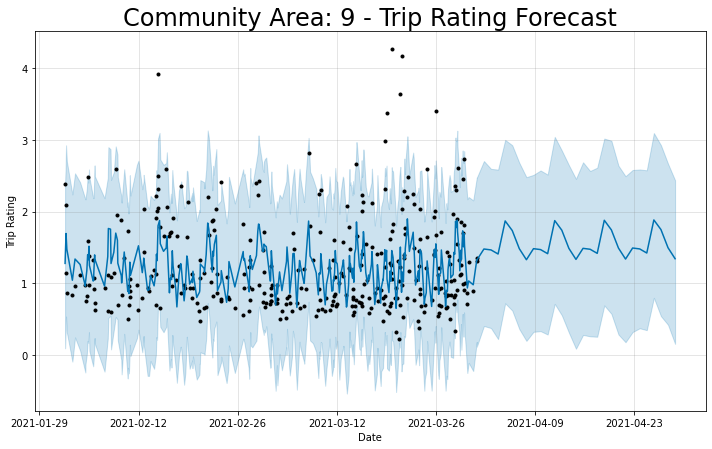

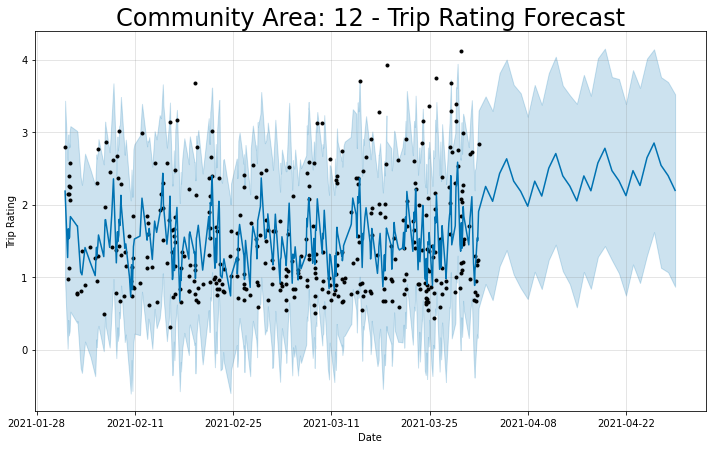

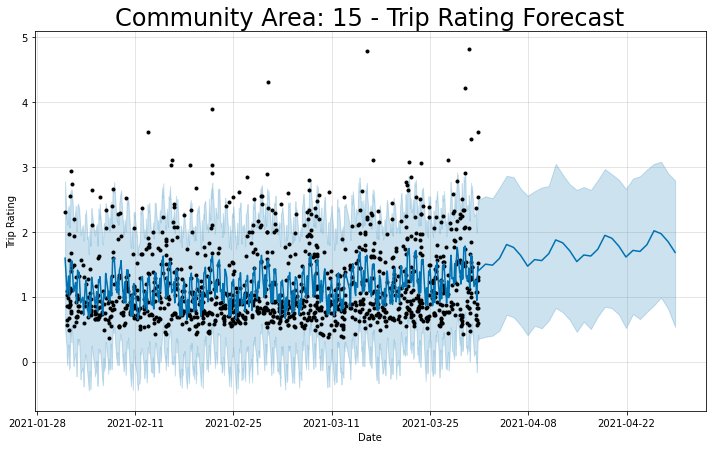

...

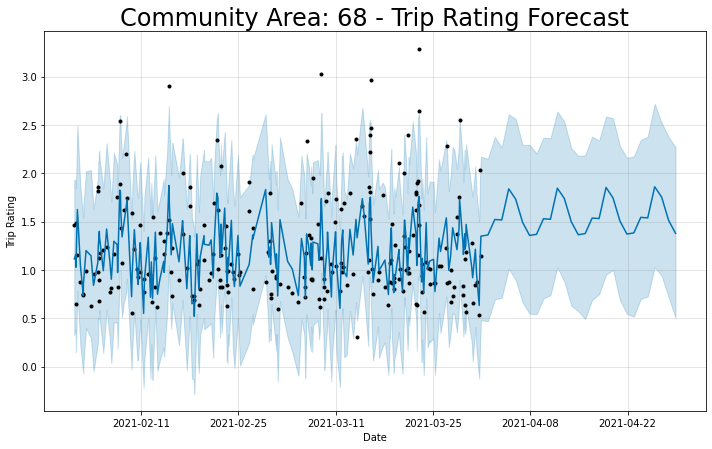

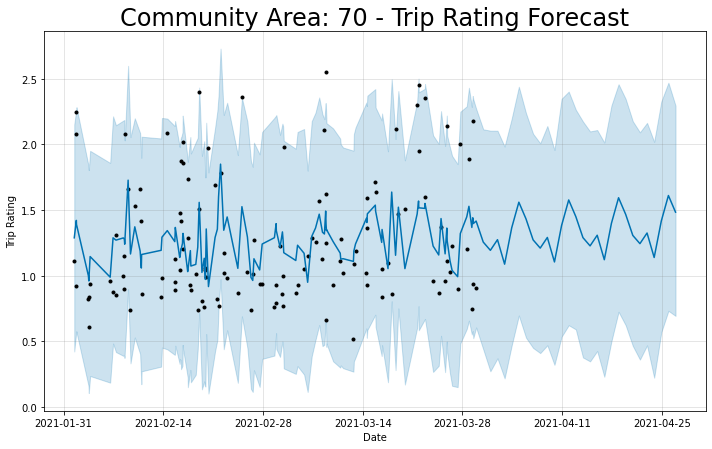

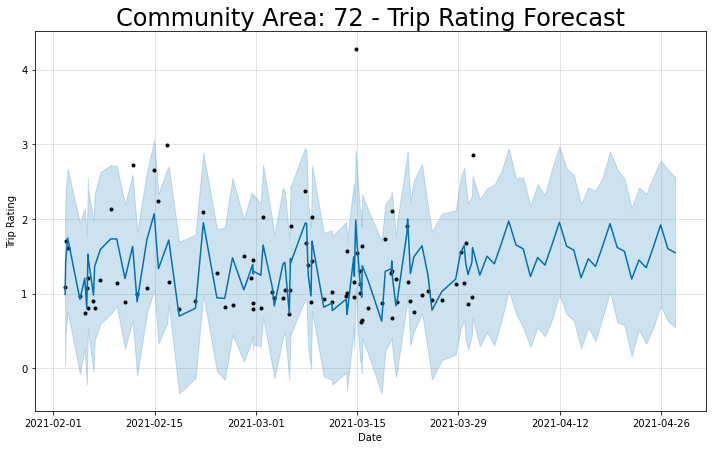

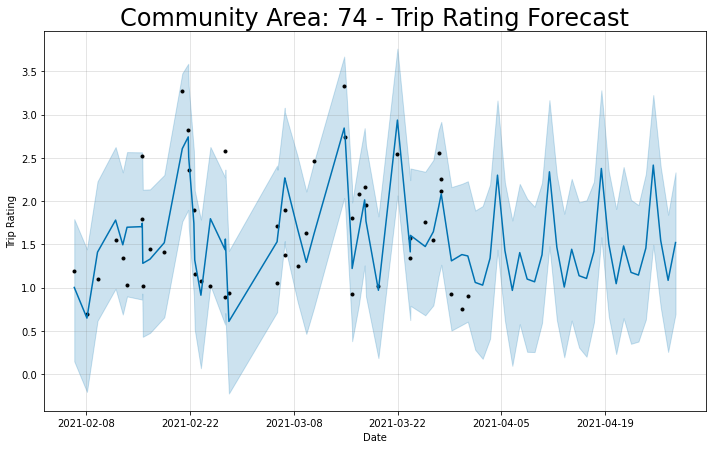

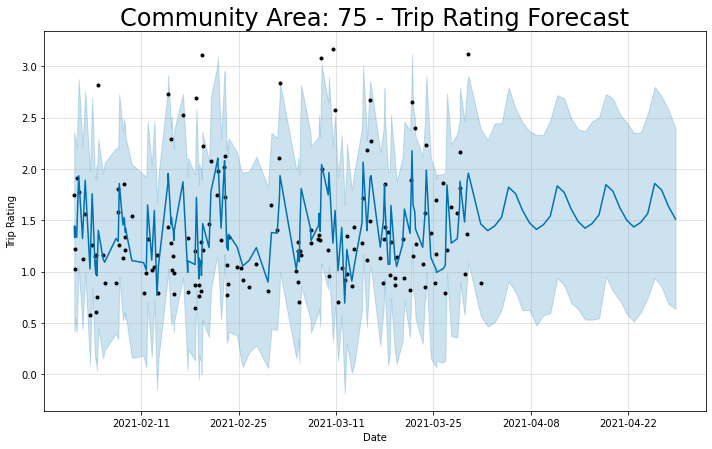

In [ ]:
for area in upandcomers:
  print('\n')
  m = do_forecasts[area]['model']
  forecast = do_forecasts[area]['forecast']

  fig = m.plot(forecast, xlabel='Date', ylabel='Trip Rating')
  ax = fig.gca()
  ax.set_title(f'Community Area: {area} - Trip Rating Forecast', size=24)
  plt.show()